In [206]:
import yaml
import cv2
import torch
import requests
import numpy as np
import gc
import torch.nn.functional as F
import pandas as pd
from matplotlib import cm
from scipy.stats import spearmanr, pearsonr

import pylab
import matplotlib.pyplot as plt
import seaborn as sns
import os
import pickle

import torchvision.models as models
import torchvision.transforms as transforms

from PIL import Image
from IPython.display import display, HTML, clear_output
from ipywidgets import widgets, Layout
from io import BytesIO
from argparse import Namespace
from maskrcnn_benchmark.config import cfg
# from VQAtools.VQAtools.vqa import VQA
import json

In [3]:
question_type = 'MultipleChoice'
annot_path = 'model_data/mscoco_val2014_annotations.json'
questions_path = 'model_data/Questions_Val_mscoco/%s_mscoco_val2014_questions.json'%(question_type)

hiecoatt_maps_dir = 'model_data/hiecoatt-val-att/p_att'
san2_maps_dir = 'model_data/san2-val-att/san2-1-val'
human_maps_dir = 'model_data/vqahat_val'
coco_images_dir = 'model_data/val2014'

We can set up some utility functions for IO and build some indices to keep track of metadata like questions, answers, images corresponding to each qid (question ID)

In [4]:
def get_hiecoatt_map(qid):
    return '%s/%s.png'%(hiecoatt_maps_dir, qid)

def get_san2_map(qid):
    return '%s/%s.png'%(san2_maps_dir, qid)

def get_human_map(qid): # note: scale here seems to be 5/8 of coco image scale
#     qid = str(qid)[:-1] + '_' + str(qid+1)[-1] # uses 1-3 for last digit where others use 0-2
    qid = str(qid) + '_1' # always use n=1
    return '%s/%s.png'%(human_maps_dir, qid)

def get_coco_image(qid):
    image_id = qid // 10
    return '%s/COCO_val2014_%s.jpg'%(coco_images_dir, str(image_id).zfill(12)) # zero pad to 12 digits

questions = json.load(open(questions_path, 'r'))
annots = json.load(open(annot_path, 'r'))

def get_coco_question(qid):
    return questions(qid)

In [5]:
# build indices
# note: image index = qid // 10
# indices to find question and answer by qid
questions_index = {}
answers_index = {}
image_paths_index = {}

def build_index(questions_path, annot_path):
    questions = json.load(open(questions_path, 'r'))
    for ques in questions['questions']:
        questions_index[int(ques['question_id'])] = ques['question']
    for ann in annots['annotations']:
        qid = int(ann['question_id'])
        answers_index[qid] = ann['multiple_choice_answer']
        image_paths_index[qid] = get_coco_image(qid)

build_index(questions_path, annot_path)

In [152]:
backwards_index = {} # question + image id to qid

def build_backwards_index(questions_path):
    questions = json.load(open(questions_path, 'r'))
    for ann in questions['questions']:
        qid = int(ann['question_id'])
        backwards_index[get_coco_image(qid) + questions_index[qid]] = qid

build_backwards_index(questions_path)

Here we figure out which qids are available in each dataset

In [7]:
# we want qids that have both a human map and are available in the validation dataset
# for some reason, there are some human maps whose corresponding question is not in our coco val dataset

# get list of images with human maps
from os import listdir
from os.path import isfile, join

human_map_files = [f for f in listdir(human_maps_dir) if isfile(join(human_maps_dir, f))]
human_map_qids = set([int(f[:-6]) for f in human_map_files])
print('# qids with human map:', len(human_map_qids))

coco_files = [f for f in listdir(coco_images_dir) if isfile(join(coco_images_dir, f))]
coco_qids = set([int(f.split('_')[2][:-4])*10 for f in coco_files])
print('# qids in coco val dataset:', len(coco_qids))

intersect_qids = coco_qids.intersection(human_map_qids)
print('# qids in both human map and coco val:', len(intersect_qids))

# now including human maps training dataset
human_maps_train_dir = 'model_data/vqahat_train'
human_map_train_files = [f for f in listdir(human_maps_train_dir) if isfile(join(human_maps_train_dir, f))]
human_map_train_qids = set([int(f[:-6]) for f in human_map_train_files])
print('# qids with human map:', len(human_map_train_qids))

print('# qids in both train human map and coco val:', len(coco_qids.intersection(human_map_train_qids)))

# sorted(list(intersect_qids))
# sorted(list(human_map_qids.difference(coco_qids)))

# qids with human map: 1374
# qids in coco val dataset: 40504
# qids in both human map and coco val: 462
# qids with human map: 58083
# qids in both train human map and coco val: 0


In [8]:
# looking at hiecoatt qids
hiecoatt_files = [f for f in listdir(hiecoatt_maps_dir) if isfile(join(hiecoatt_maps_dir, f))]
hiecoatt_files.remove('.DS_Store')
hiecoatt_qids = set([int(f[:-4]) for f in hiecoatt_files])
print('# qids in hiecoatt dataset:', len(hiecoatt_qids))

# looking at san2 qids
san2_files = [f for f in listdir(san2_maps_dir) if isfile(join(san2_maps_dir, f))]
san2_qids = set([int(f[:-4]) for f in san2_files])
print('# qids in san2 dataset:', len(san2_qids))

# look at intersection of coco, human maps, hiecoatt, san2
intersect_all_qids = coco_qids.intersection(human_map_qids, hiecoatt_qids, san2_qids)
print('# qids in both human map and coco val:', len(intersect_all_qids))

qids_list = list(intersect_all_qids)

# qids in hiecoatt dataset: 1490
# qids in san2 dataset: 114200
# qids in both human map and coco val: 425


In [9]:
# export indices for utility
import json
file_suffix = '_mscoco_val2014_' + question_type
with open('model_metadata/questions_index%s.json'%(file_suffix), 'w') as f:
    json.dump(questions_index, f)
with open('model_metadata/answers_index%s.json'%(file_suffix), 'w') as f:
    json.dump(answers_index, f)
with open('model_metadata/image_paths_index%s.json'%(file_suffix), 'w') as f:
    json.dump(image_paths_index, f)

In [10]:
# export batched version to generate masks
file_suffix = '_mscoco_val2014_' + question_type
batched_index = {}
# batched by image to save computation of image feature
# batched_index has the form [(file_name, [question_1, ...], [answer_1, ...]), (...), ...]
# i.e. list of tuples where each tuple corresponds to an image
for qid in human_map_qids:
    img_id = qid//10
    if img_id in batched_index:
        batched_index[img_id][1].append(questions_index[qid])
        batched_index[img_id][2].append(answers_index[qid])
    else:
        batched_index[img_id] = (image_paths_index[qid], [questions_index[qid]], [answers_index[qid]])

# save list of values
import pickle
with open('model_metadata/batched_index_list%s.pickle'%(file_suffix), 'wb') as f:
    pickle.dump(list(batched_index.values()), f)

It is also interesting to examine the outputs from the HieCoAtt and San2 models

In [11]:
# import torchfile

# hiecoatt_model = torchfile.load('model_data/model_parallel_train_vgg.t7')

Compare with results of running visual attribution techniques on Kazemi and Elqursh's 2017 model

In [12]:
# import and process deconvnet maps
# import skimage.measure
# block_size = 1

with open('model_data/kazemi_maps/ans_deconvnet.pickle', 'rb') as f:
    deconv_maps = pickle.load(f)
#     for img in range(len(deconv_maps)):
#         for ques in range(len(img)):
#             mask = deconv_maps[img][ques]['attr_heatmap']
#             mask = skimage.measure.block_reduce(mask, (block_size, block_size, 1), np.mean)
#             deconv_maps[img][ques]['attr_heatmap'] = mask

flat_deconv_maps = [item for sublist in deconv_maps for item in sublist]

deconv_map_index = {}
for att_map in flat_deconv_maps:
    qid = image_path_to_qid[att_map['input_imgname']]
    mask = att_map['attr_heatmap']
#     deconv_map_index[qid] = np.linalg.norm(mask, axis=2)
    deconv_map_index[qid] = np.max(np.abs(mask), axis=2)
#     mask = skimage.measure.block_reduce(mask, (block_size, block_size, 1), np.mean)
    # try pooling/block reducing to make map more human readable
#     deconv_map_index[qid] = np.e ** att_map['attr_heatmap'][:,:,0]

Now, we explore and compare the attention maps

In [390]:
# turns image into a normalized np array
def normalize_mask(mask, extra_norm=False):
    overlay = np.asarray(mask)
    overlay -= overlay.min()
    overlay = overlay / (overlay.max() + 1e-6)
    if extra_norm:
        overlay -= overlay.mean()
        overlay = overlay / (overlay.std() + 1e-6)
        overlay = 1 / (1 + np.exp(-overlay))
#         overlay *= 255
#     overlay = overlay / (overlay.sum() + 1e-6)
    return overlay

# don't overlay, just make the same size
def resize_images(img, mask, colormap='jet', alpha=0.7, extra_norm=False):
    # resize, normalize, apply colormap
    overlay = np.asarray(mask.resize(img.size, resample=Image.BICUBIC))
    
    Z = overlay
    Z = (Z - Z.min())
    Z = Z / (Z.max() + 1e-6)
    Z -= Z.mean()
    Z = Z / (Z.std() + 1e-6)
    Z = 1 / (1 + np.exp(-Z))

    im = plt.imshow(Z, cmap=colormap)
#     plt.colorbar(im, orientation='horizontal')
    plt.show()

def display_mask(overlay, colormap='jet'):
#     overlay -= overlay.min()
#     overlay = overlay / (overlay.max() + 1e-6)
#     overlay -= overlay.mean()
#     overlay = overlay / (overlay.std() + 1e-6)
#     overlay = 1 / (1 + np.exp(-overlay))
#     overlay *= 255
#     im = plt.imshow(overlay, cmap=colormap)
#     plt.colorbar(overlay, orientation='horizontal')
#     plt.show()
    Z = overlay
    Z = (Z - Z.min())
    Z = Z / (Z.max() + 1e-6)
    Z -= Z.mean()
    Z = Z / (Z.std() + 1e-6)
    Z = 1 / (1 + np.exp(-Z))

    im = plt.imshow(Z, cmap=colormap)
#     plt.colorbar(im, orientation='horizontal')
    plt.show()

def overlay_images(img, mask, colormap='jet', alpha=0.7):
    # resize, normalize, apply colormap
    overlay = mask.resize(img.size, resample=Image.BICUBIC)
    overlay = normalize_mask(overlay)
    cmap = cm.get_cmap(colormap)
    overlay = (255*cmap(overlay ** 2)[:,:,:3]).astype(np.uint8)
    # overlay the image with the mask
    overlayed_img = Image.fromarray((alpha * np.asarray(img) + (1 - alpha) * overlay).astype(np.uint8))
    return overlayed_img

fixed_size = (448, 448)
def preprocess_maps(map1, map2):
#     if isinstance(map1, np.ndarray):
#         map1 = Image.fromarray(map1)
#     if isinstance(map2, np.ndarray):
#         map2 = Image.fromarray(map2)
    map1 = map1.resize(fixed_size)
    map2 = map2.resize(fixed_size)
    
    map1 = np.asarray(map1).flatten()
    map2 = np.asarray(map2).flatten()
    map1 = map1 / (map1.sum() + 1e-6)
    map2 = map2 / (map2.sum() + 1e-6)
    return map1, map2

def rank_corr_maps(map1, map2):
    map1, map2 = preprocess_maps(map1, map2)
    corr, p = spearmanr(map1, map2)
    return corr

def intersect_maps(map1, map2):
    map1, map2 = preprocess_maps(map1, map2)
    return np.sum(map1 * map2)

def threshold_maps(map1, map2):
    mean1 = map1.mean()+map1.std()
    mean2 = map2.mean()+map2.std()
    map1[map1 > mean1] = 1e6
    map1[map1 <= mean1] = 0
    map1[map1 > mean1] = 1
    map2[map2 > mean2] = 1e6
    map2[map2 <= mean2] = 0
    map2[map2 > mean2] = 1
    return map1, map2

def threshold_maps2(map1, map2, k=int(0.05*448*448)): # top k
    ind1 = np.argpartition(map1, -k)[-k:]
    ind2 = np.argpartition(map2, -k)[-k:]
    map1.fill(0)
    map1[ind1] = 1
    map2.fill(0)
    map2[ind2] = 1
    return map1, map2

def rank_corr_maps(map1, map2):
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    corr, p = spearmanr(map1, map2)
    return corr

def disc_intersect_maps(map1, map2):
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    return np.sum(map1 * map2)

def disc_IoU_maps(map1, map2): # IoU = I / U (I = intersection, U = union)
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    union = map1+map2
    union[union > 0] = 1
    return np.sum(map1 * map2)/(np.sum(union)+1e-6)

def disc_dice_maps(map1, map2): # dice coefficient = 2 I / (I + U)
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    union = map1+map2
    union[union > 0] = 1
    return 2 * np.sum(map1 * map2)/(np.sum(map1 * map2) + np.sum(union) + 1e-6)

def disc_precision_maps(map1, map2): # map1 is ground truth
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    return np.sum(map1 * map2)/(np.sum(map2) + 1e-6)

def disc_recall_maps(map1, map2): # map1 is ground truth
    map1, map2 = preprocess_maps(map1, map2)
    map1, map2 = threshold_maps(map1, map2)
    return 2 * np.sum(map1 * map2)/(np.sum(map1) + 1e-6)

def disc_f1_maps(map1, map2): # map1 is ground truth
    prec = disc_precision_maps(map1, map2)
    rec = disc_recall_maps(map1, map2)
    return 2*prec*rec/(prec+rec+1e-6)

# def disc_precision_maps(map1, map2): # dice coefficient = 2 I / (I + U)
#     map1, map2 = threshold_maps(preprocess_maps(map1, map2))
#     union = np.sum(map1+map2)
#     union[union > 0] = 1
#     return 2 * np.sum(map1 * map2)/(np.sum(map1 * map2) + np.sum(union))

def compare_maps(qid, kazemi=True, hiecoatt=True, sans2=True):
    print('Question ID:', qid)
    print('Question:', questions_index[qid])
    print('Answer:', answers_index[qid])
    img = Image.open(get_coco_image(qid))
    human_map = Image.open(get_human_map(qid))
    
#     if kazemi: # every image with human map has a kazemi map
#         print('Kazemi deconv map:')
#         deconv_map = Image.fromarray(np.uint8(deconv_map_index[qid]))
# #         display(resize_images(img, deconv_map)) # interacts with resize strangely
#         display_mask(deconv_map_index[qid])
#         print('Rank correlation:', rank_corr_maps(human_map, deconv_map))
    if hiecoatt:
        if qid not in hiecoatt_qids:
            return
        print('HieCoAttentionVQA attention:')
        hiecoatt_map = Image.open(get_hiecoatt_map(qid))
        display(overlay_images(img, hiecoatt_map))
# #     print('Prediction:', answers_index[qid])
        print('Rank correlation:', rank_corr_maps(human_map, hiecoatt_map))
    if sans2:
        if qid not in san2_qids:
            return
        print('San2 attention:')
        san2_map = Image.open(get_san2_map(qid))
        display(overlay_images(human_map, san2_map))
        print('Rank correlation:', rank_corr_maps(human_map, san2_map))
    print('Human attention:')
    display(overlay_images(img, human_map))

Question ID: 2023430
Question: Is this mobile ready for use?
Answer: no
HieCoAttentionVQA attention:


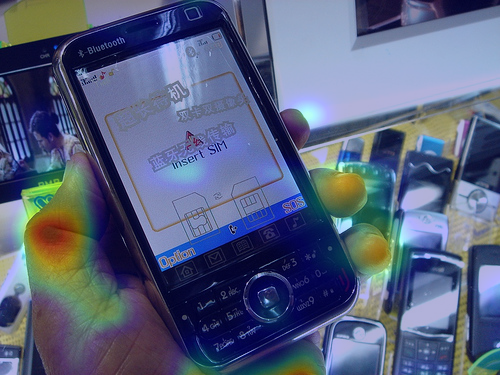

Rank correlation: -0.15168097496668279
San2 attention:
Question ID: 2023431
Question: What does the screen say?
Answer: insert sim
Human attention:


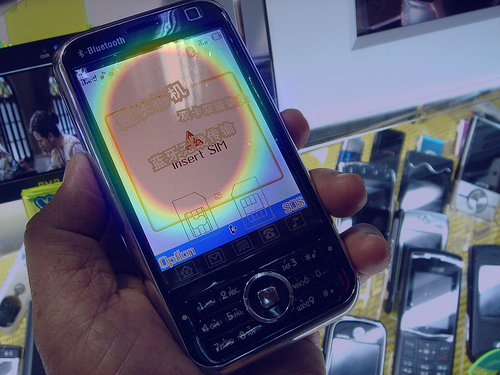

Question ID: 2023432
Question: Are all the phones the same?
Answer: no
Human attention:


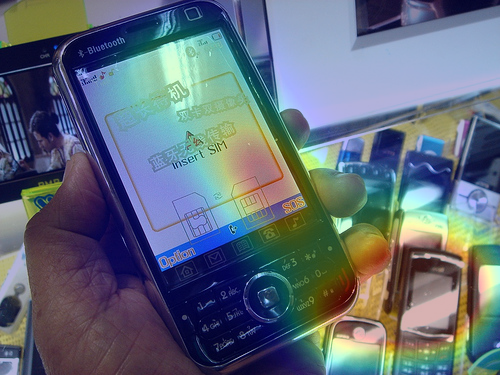

Question ID: 2555920
Question: Is this a school class?
Answer: yes
HieCoAttentionVQA attention:


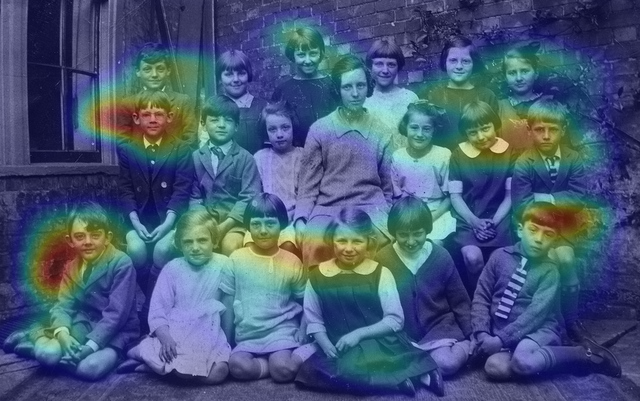

Rank correlation: 0.14088783385005973
San2 attention:
Question ID: 2555921
Question: Is this in color?
Answer: no
Human attention:


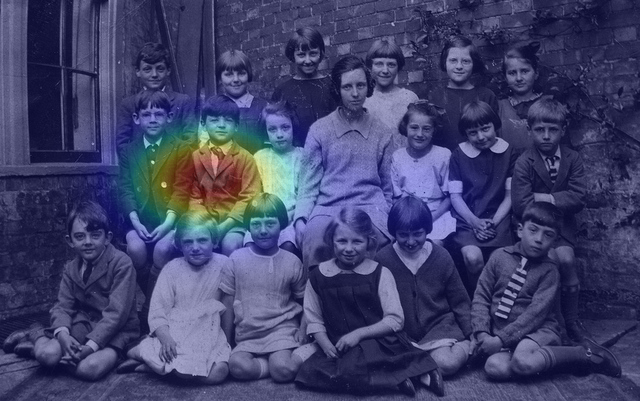

Question ID: 2555922
Question: Are the people inside or outside?
Answer: outside
Human attention:


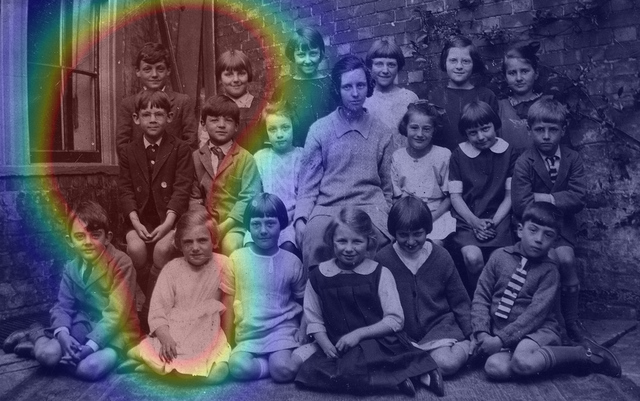

Question ID: 5636150
Question: What is the lady holding?
Answer: gorillapod
HieCoAttentionVQA attention:


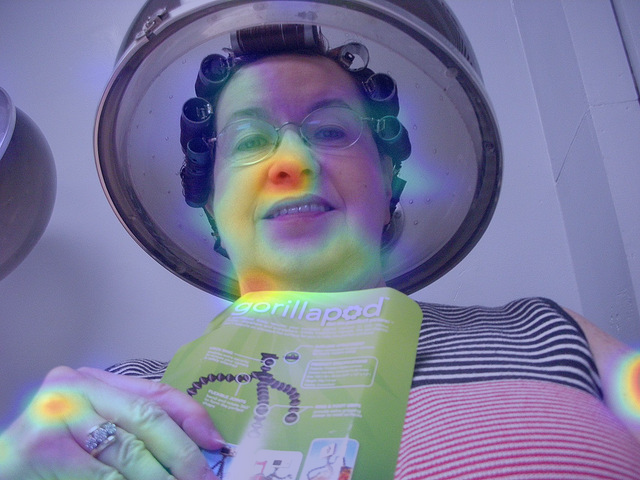

Rank correlation: 0.07667130364067411
San2 attention:
Question ID: 5636151
Question: What is the woman doing?
Answer: getting her hair done
Human attention:


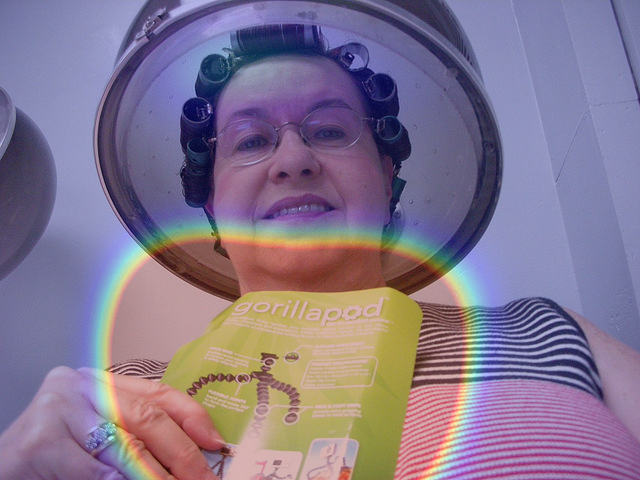

Question ID: 5636152
Question: Does the woman have perfect vision?
Answer: no
Human attention:


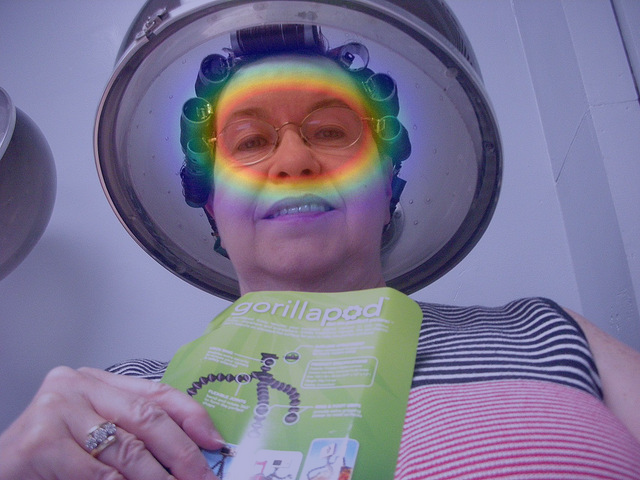

Question ID: 5578840
Question: Is this a blurred photo?
Answer: no
HieCoAttentionVQA attention:


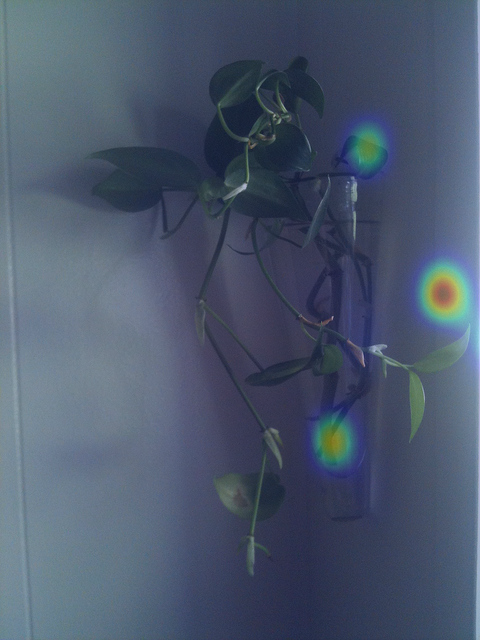

Rank correlation: -0.015487285351822725
San2 attention:
Question ID: 5578841
Question: What color is the plant?
Answer: green
Human attention:


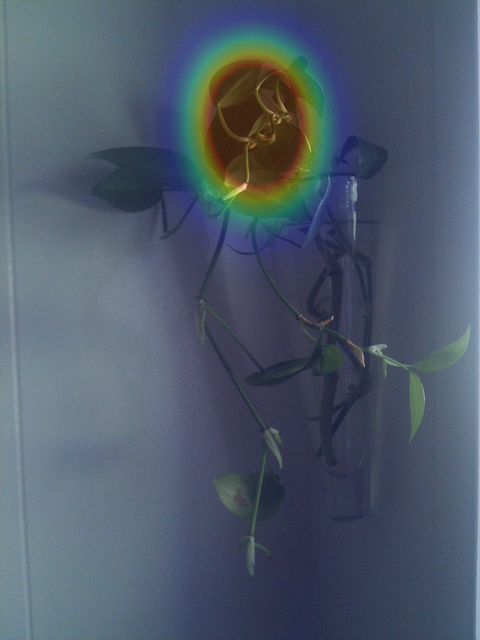

Question ID: 5578842
Question: Is there water in the vase?
Answer: yes
Human attention:


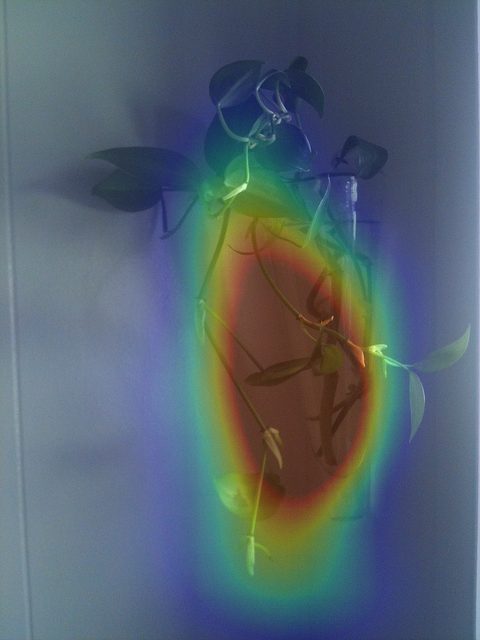

Question ID: 4341870
Question: Are there people in jail?
Answer: yes
HieCoAttentionVQA attention:


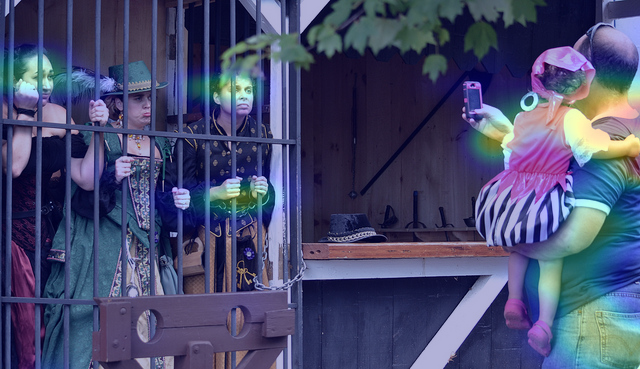

Rank correlation: -0.028147720247926396
San2 attention:
Question ID: 4341871
Question: What color is the man's shirt?
Answer: blue
Human attention:


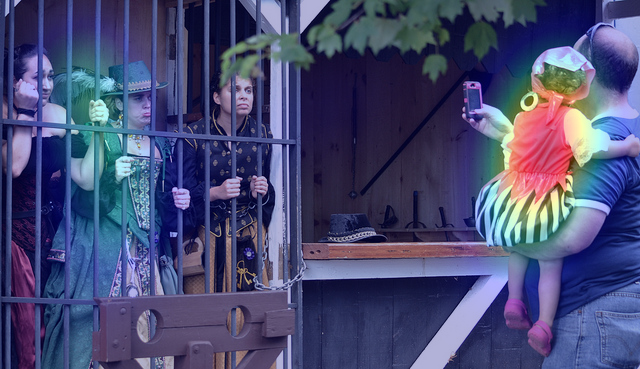

Question ID: 4341872
Question: Where are the people behind the bars?
Answer: in jail
Human attention:


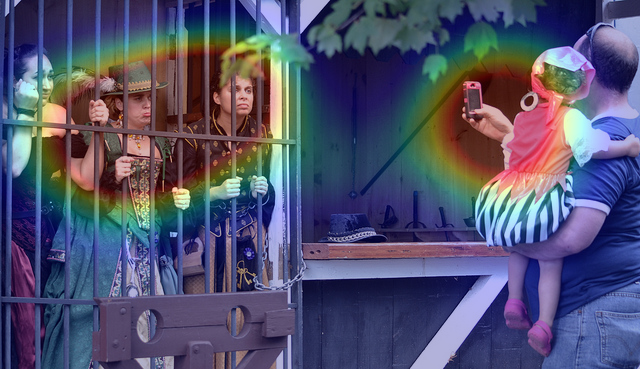

Question ID: 5759090
Question: What time of day is this picture?
Answer: afternoon
HieCoAttentionVQA attention:


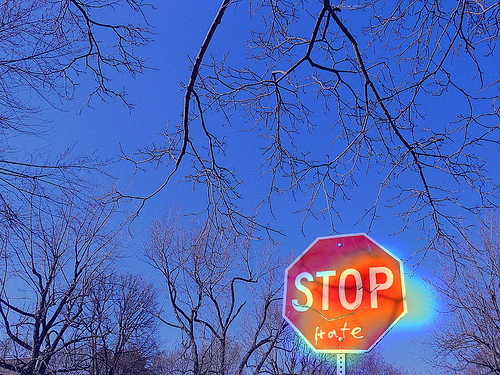

Rank correlation: 0.06955701751879555
San2 attention:
Question ID: 5759091
Question: What does the sign say?
Answer: stop hate
Human attention:


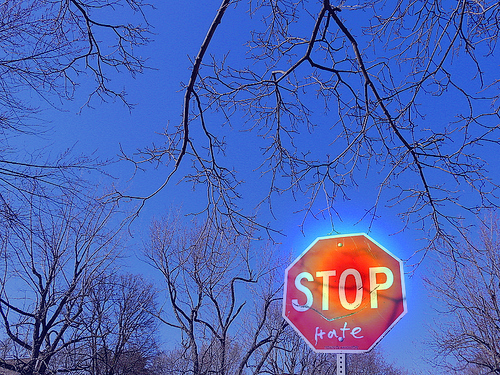

Question ID: 5759092
Question: Are both the words suppose to be there?
Answer: no
Human attention:


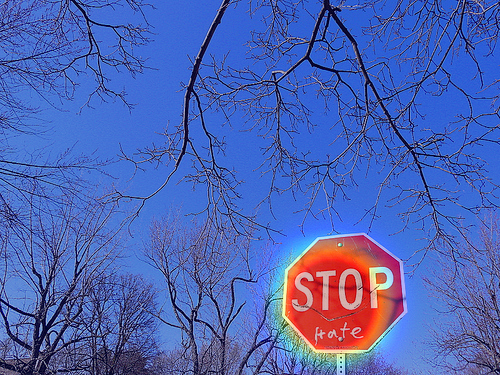

Question ID: 712830
Question: What kind of home-improvement project is in progress here?
Answer: painting
HieCoAttentionVQA attention:


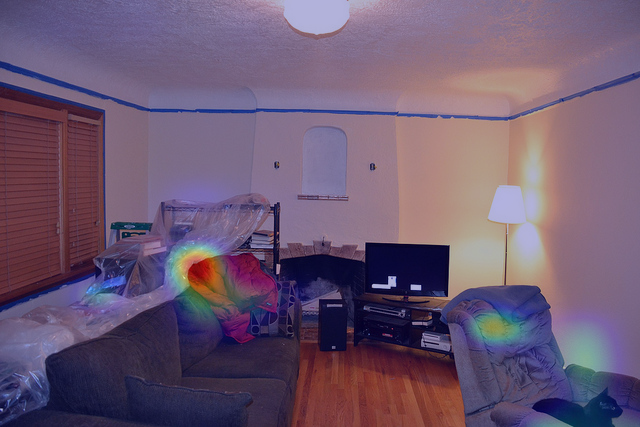

Rank correlation: 0.20775532913611924
San2 attention:
Question ID: 712831
Question: Is this room messy?
Answer: yes
Human attention:


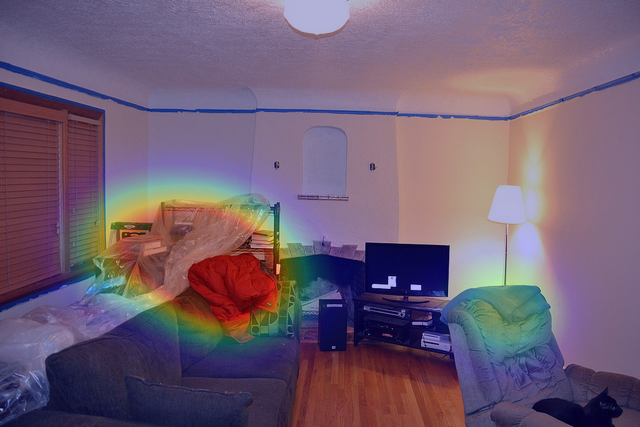

Question ID: 712832
Question: What type of furniture is the cat sitting on?
Answer: recliner
Human attention:


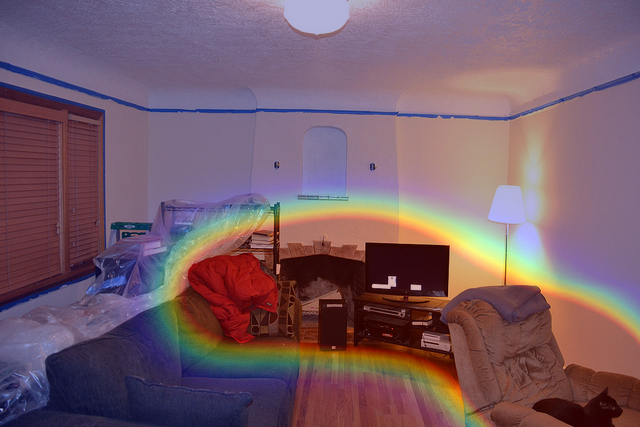

Question ID: 1679520
Question: What are the leaves in the noodles?
Answer: cilantro
HieCoAttentionVQA attention:


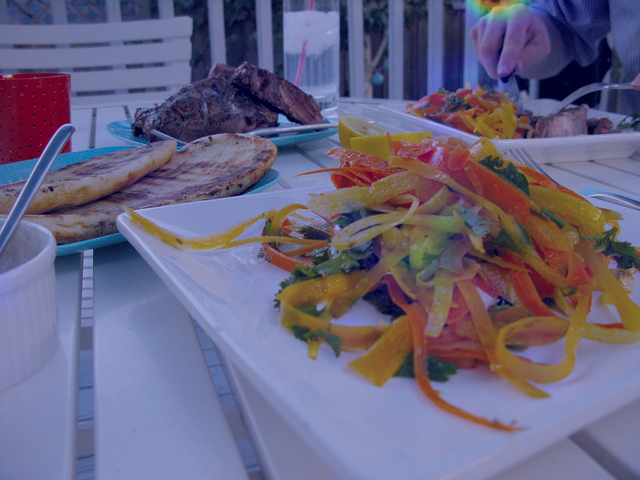

Rank correlation: 0.30922853304079867
San2 attention:
Question ID: 1679521
Question: What is the yellow food in the dish?
Answer: peppers
Human attention:


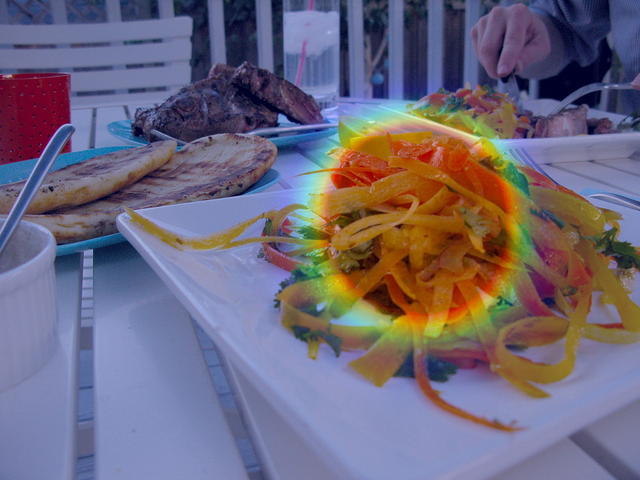

Question ID: 1679522
Question: What color is the table?
Answer: white
Human attention:


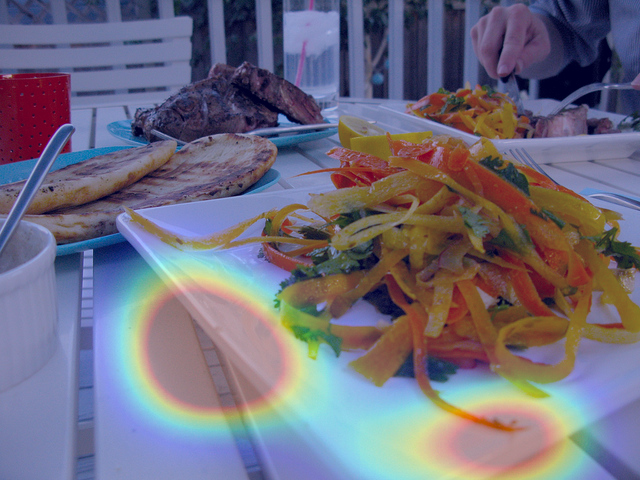

Question ID: 4653230
Question: What color is the goggles on the snowboarder?
Answer: blue
Question ID: 4653231
Question: What season is this?
Answer: winter
Human attention:


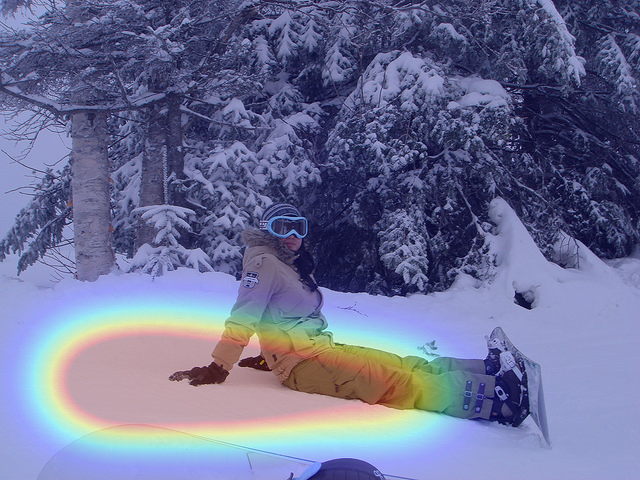

Question ID: 4653232
Question: Is she sleeping?
Answer: no
Human attention:


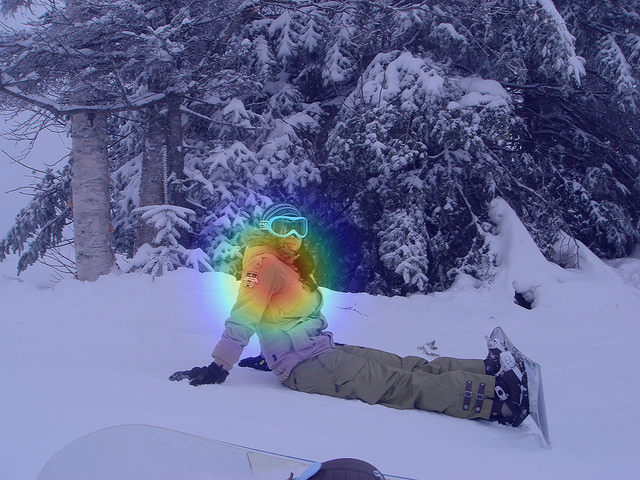

Question ID: 1843380
Question: Are the headlights illuminated?
Answer: no
HieCoAttentionVQA attention:


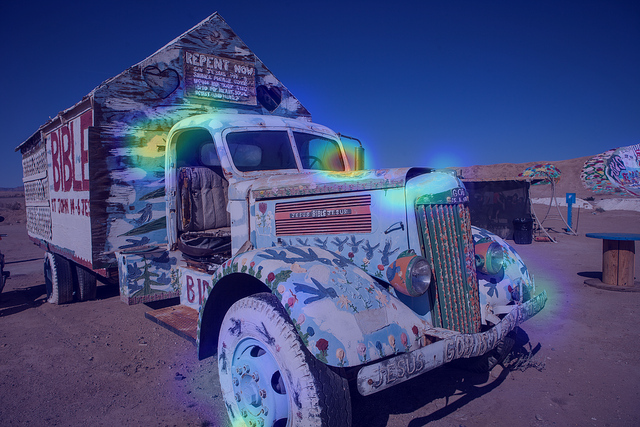

Rank correlation: 0.023632597543732568
San2 attention:
Question ID: 1843381
Question: Did the artist mean for this truck to blend in with the beach?
Answer: no
Human attention:


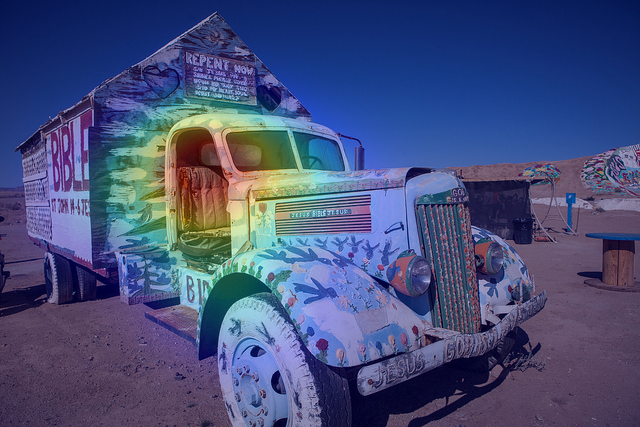

Question ID: 1843382
Question: What is the time of day?
Answer: noon
Human attention:


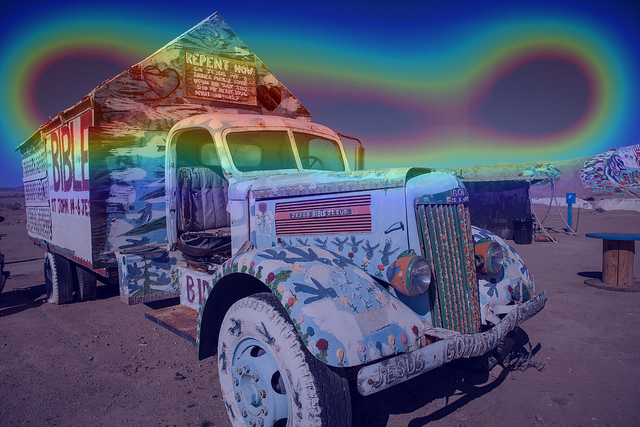

In [396]:
initial_maps = [x//10*10 for x in deconv_map_index.keys()]
for x in initial_maps:
    try:
        compare_maps(x, kazemi=True, hiecoatt=True, sans2=True)
    except:
        pass
    try:
        compare_maps(x+1, kazemi=True, hiecoatt=False, sans2=False)
    except:
        pass
    try:
        compare_maps(x+2, kazemi=True, hiecoatt=False, sans2=False)
    except:
        pass

Now we compare some of our attribution methods using these metrics

In [493]:
# compile all kazemi maps for different attribution techniques in a given folder
kazemi_paths = {'deconv': [], 'ggrdcm': [], 'gbackp': [], 'salien': []}
kazemi_dir = 'model_data/kazemi_maps_70'

for f in os.listdir(kazemi_dir):
    try:
        substr = f[:f.index('-')]
        kazemi_paths[substr].append(kazemi_dir + '/' + f)
    except:
        print(f, 'is not in the right form')
        pass

flat_maps = []
att_types = []
for att_type in kazemi_paths.keys():
    for path in kazemi_paths[att_type]:
        with open(path, 'rb') as f:
            flat_maps_i = pickle.load(f)
            flat_maps += flat_maps_i
            att_types += [att_type] * len(flat_maps_i)

.DS_Store is not in the right form


In [494]:
def build_data(flat_maps):
    bad_qids = 0
    df = pd.DataFrame(columns=['qid', 'image_path', 'question', 'answer', 'att_type',\
                           'prediction', 'confidence', 'att_target', 'mismatch', 'on_prediction',\
                           'map', 'rank_corr', 'intersect', 'precision', 'recall',\
                           'disc_intersect', 'IoU', 'dice', 'f1'])
    
    for att_map, att_type in zip(flat_maps, att_types):
        qid = backwards_index[att_map['input_imgname'] + att_map['input_question']]
        if qid not in human_map_qids:
            print(qid,'not found in human map qids')
            bad_qids += 1
            continue
#         qid = image_path_to_qid[att_map['input_imgname']]
        orig_mask = np.max(np.abs(att_map['attr_heatmap']), axis=2)
        overlay = orig_mask
        overlay -= overlay.min()
        overlay = overlay / (overlay.max() + 1e-6)
        overlay -= overlay.mean()
        overlay = overlay / (overlay.std() + 1e-6)
        orig_mask = overlay
        mask = Image.fromarray(np.uint8(orig_mask))
        human_map = Image.open(get_human_map(qid))
        df = df.append({'qid': qid, 'image_path': image_paths_index[qid], 'question': questions_index[qid],\
                       'answer': answers_index[qid], 'att_type': att_type, 'prediction': att_map['model_pred'],\
                        'confidence': att_map['model_conf'], 'att_target': att_map['attr_target'],\
                        'mismatch': answers_index[qid] != att_map['model_pred'],\
                        'on_prediction': att_map['model_pred'] == att_map['attr_target'],\
                        'map': orig_mask, 'rank_corr': rank_corr_maps(human_map, mask), 'intersect': intersect_maps(human_map, mask),\
                        'precision': disc_precision_maps(human_map, mask), 'recall': disc_recall_maps(human_map, mask),\
                        'disc_intersect': disc_intersect_maps(human_map, mask), 'IoU': disc_IoU_maps(human_map, mask),\
                        'dice': disc_dice_maps(human_map, mask), 'f1': disc_f1_maps(human_map, mask)}, ignore_index=True)
    print('unknown qids:', bad_qids)
    return df

In [495]:
# build and save
df = build_data(flat_maps)
df.to_csv('model_metadata/kazemi_eval2.csv')

/Users/mt/anaconda3/envs/cos429/lib/python3.7/site-packages/scipy/stats/stats.py:4264: SpearmanRConstantInputWarning: An input array is constant; the correlation coefficent is not defined.
  warnings.warn(SpearmanRConstantInputWarning())


unknown qids: 0


In [496]:
# compute means
# df_means = df.loc[:, df.columns != 'rank_corr'].dropna().groupby('att_type').mean()
df_means = df.dropna().groupby('att_type').mean()
df_means

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
att_type,,,,,,,,,
deconv,0.580240,0.048181,0.000005,0.179855,0.275433,4150.078838,0.096308,0.149338,0.206950
gbackp,0.588125,0.121008,0.000008,0.367891,0.226241,3604.289362,0.092048,0.160790,0.254107
ggrdcm,0.588125,0.090062,0.000008,0.395360,0.104836,1626.795745,0.048549,0.088946,0.156122
salien,0.580240,0.109101,0.000007,0.294777,0.329459,5387.792531,0.120677,0.205789,0.301966


In [497]:
# compute means
# df_means = df.loc[:, df.columns != 'rank_corr'].dropna().groupby('att_type').mean()
df_means2 = df.dropna().groupby('att_type').agg([np.mean, np.std])
df_means2

confidence           rank_corr           intersect            \
               mean       std      mean       std      mean       std   
att_type                                                                
deconv     0.580240  0.278302  0.048181  0.224476  0.000005  0.000003   
gbackp     0.588125  0.274065  0.121008  0.135484  0.000008  0.000004   
ggrdcm     0.588125  0.274065  0.090062  0.122780  0.000008  0.000005   
salien     0.580240  0.278302  0.109101  0.152269  0.000007  0.000003   

         precision              recall           disc_intersect               \
              mean       std      mean       std           mean          std   
att_type                                                                       
deconv    0.179855  0.237159  0.275433  0.393055    4150.078838  5791.366371   
gbackp    0.367891  0.259885  0.226241  0.181924    3604.289362  2869.492473   
ggrdcm    0.395360  0.327280  0.104836  0.105067    1626.795745  1606.248749   
salien    0.294777  0.190456  0.329459  0.211445    5387.792531  3312.464080   

               IoU                dice                  f1            
              mean       std      mean       std      mean       std  
att_type                                                              
deconv    0.096308  0.141110  0.149338  0.206420  0.206950  0.283701  
gbackp    0.092048  0.072236  0.160790  0.118499  0.254107  0.180277  
ggrdcm    0.048549  0.046986  0.088946  0.082049  0.156122  0.138429  
salien    0.120677  0.084070  0.205789  0.128746  0.301966  0.189354

In [545]:
def plot_corr(sub_df):
    print('pearson')
    # corr, p = pearsonr(sub_df['confidence'], sub_df['IoU'])
    # corr matrix
    corr = sub_df.corr()
    mask = np.triu(np.ones_like(corr, dtype=bool))
    # mask = np.ndarray(len(corr))
    # print(corr.iloc[:,0].shape)

    # plot heatmap
    f, ax = plt.subplots(figsize=(11, 9))
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    plot = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
    # plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
    plot.set_yticklabels(plot.get_yticklabels(), rotation=0, verticalalignment='top')
    plt.show()
    
    print('spearman')
    # corr, p = pearsonr(sub_df['confidence'], sub_df['IoU'])
    # corr matrix
    corr = sub_df.corr(method='spearman')
    mask = np.triu(np.ones_like(corr, dtype=bool))
    # mask = np.ndarray(len(corr))
    # print(corr.iloc[:,0].shape)

    # plot heatmap
    f, ax = plt.subplots(figsize=(11, 9))
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    plot = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
    # plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
    plot.set_yticklabels(plot.get_yticklabels(), rotation=0, verticalalignment='top')
    plt.show()

def plot_histograms(sub_df):
    display(sub_df.describe())
    sub_df.hist(bins=20, figsize=(10, 8))
    plt.show()
    
def plot_diff(diff_df):
    # print
#     display(diff_df)
    
    # plot
    f, ax = plt.subplots(figsize=(10, 8))
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    plot = sns.heatmap(diff_df, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
    plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
    plot.set_yticklabels(plot.get_yticklabels(), rotation=45, verticalalignment='top')
    plt.ylabel('Attribution Technique')
    plt.xlabel('Metric')
    plt.show()
    
    # now excluding disc intersect, which is often an outlier
#     diff_df = diff_df.loc[:, (diff_df.columns != ('disc_intersect','mean'))&( diff_df.columns != ('disc_intersect','std'))]
    diff_df = diff_df.loc[:, (diff_df.columns != 'disc_intersect')]

    #print
#     diff_df2 = diff_df.loc[:, (diff_df.columns != ('precision','mean'))&( diff_df.columns != ('disc_intersect','std'))]
#     display(diff_df)
    
    # plot
    f, ax = plt.subplots(figsize=(10, 8))
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    plot = sns.heatmap(diff_df, cmap=cmap, vmax=.3, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
    plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
    plot.set_yticklabels(plot.get_yticklabels(), rotation=45, verticalalignment='top')
    plt.ylabel('Attribution Technique')
    plt.xlabel('Metric')
    plt.show()

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
count,984.000000,952.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000,984.000000
mean,0.584057,0.091918,0.000007,0.298527,0.227218,3585.296748,0.086721,0.146620,0.222614
std,0.276718,0.166022,0.000004,0.271869,0.259876,3956.290157,0.096229,0.147642,0.212636
min,0.033164,-0.194454,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.331055,-0.041713,0.000004,0.045704,0.020423,354.000000,0.007922,0.015720,0.025667
50%,0.612367,0.061185,0.000006,0.252495,0.140347,2224.500000,0.057179,0.108173,0.172311
75%,0.834145,0.206003,0.000009,0.477777,0.349626,5716.750000,0.134285,0.236775,0.364834
max,0.999796,0.685191,0.000022,1.000000,1.485394,19785.000000,0.553566,0.712639,0.965012


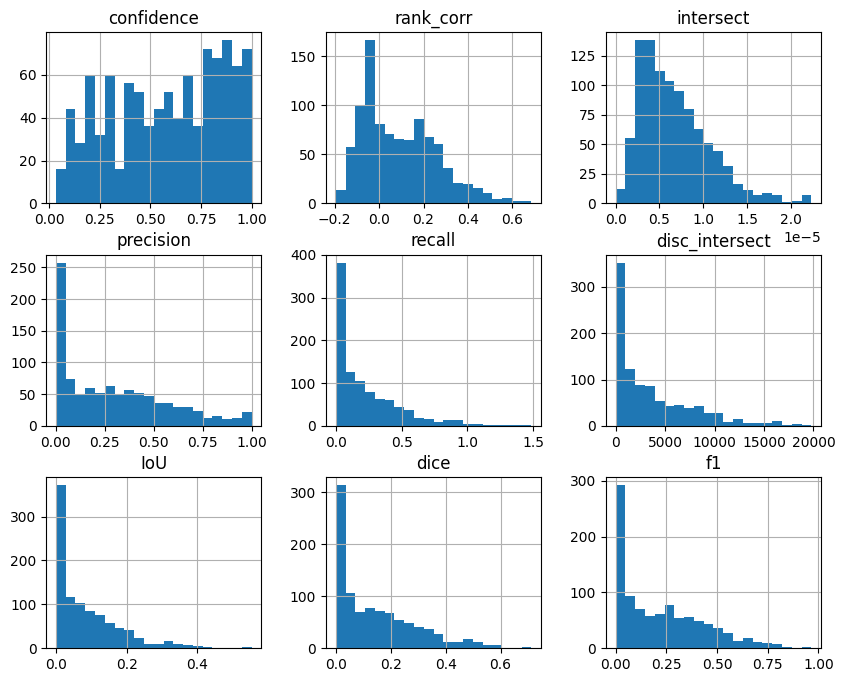

In [546]:
# describe entire data
plot_histograms(df)

In [547]:
df

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
0,606410,model_data/val2014/COCO_val2014_000000060641.jpg,How many pieces of pizza have been eaten?,5,deconv,0,0.659595,5,True,False,"[[-1.035783, -1.0190113, -0.9408219, -1.002960...",-0.086640,0.000002,0.006594,0.001462,34.0,0.000659,0.001316,0.002393
1,606410,model_data/val2014/COCO_val2014_000000060641.jpg,How many pieces of pizza have been eaten?,5,deconv,0,0.659595,0,True,True,"[[-1.0978135, -1.0789884, -0.98587835, -1.0585...",-0.113485,0.000002,0.017850,0.007354,171.0,0.003058,0.006098,0.010416
2,606411,model_data/val2014/COCO_val2014_000000060641.jpg,Are the pizzas all the same?,no,deconv,no,0.880395,no,False,True,"[[-1.1524205, -1.1257764, -0.97535366, -1.0888...",-0.114896,0.000003,0.026430,0.023948,421.0,0.008309,0.016481,0.025127
3,3547360,model_data/val2014/COCO_val2014_000000354736.jpg,Which skier is moving away from the other skiers?,one in front,deconv,right,0.131426,one in front,True,False,"[[-0.86764705, -0.84766084, -0.9381518, -0.886...",0.084236,0.000005,0.226440,0.397179,5942.0,0.118319,0.211602,0.288436
4,3547360,model_data/val2014/COCO_val2014_000000354736.jpg,Which skier is moving away from the other skiers?,one in front,deconv,right,0.131426,right,True,True,"[[-0.7284996, -0.6756967, -0.9145558, -0.77745...",-0.036968,0.000003,0.001266,0.000134,2.0,0.000063,0.000127,0.000242
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
979,1500070,model_data/val2014/COCO_val2014_000000150007.jpg,Is the plane flying too low?,no,salien,yes,0.709616,no,True,False,"[[-0.56827736, -0.70268726, -0.6005553, -0.577...",0.265831,0.000010,0.496249,0.531278,9856.0,0.209221,0.346043,0.513166
980,1500070,model_data/val2014/COCO_val2014_000000150007.jpg,Is the plane flying too low?,no,salien,yes,0.709616,yes,True,True,"[[-0.5627196, -0.6739357, -0.59765583, -0.5792...",0.262055,0.000010,0.494576,0.521036,9666.0,0.205743,0.341271,0.507461
981,1500071,model_data/val2014/COCO_val2014_000000150007.jpg,What part of the tree would you trim up?,top,salien,pine,0.376790,top,True,False,"[[-0.44737506, -0.6691829, -0.5014081, -0.4417...",-0.041058,0.000004,0.112861,0.120770,1963.0,0.040949,0.078676,0.116682
982,1500071,model_data/val2014/COCO_val2014_000000150007.jpg,What part of the tree would you trim up?,top,salien,pine,0.376790,pine,True,True,"[[-0.5073297, -0.6627058, -0.49985904, -0.4560...",-0.058522,0.000004,0.090425,0.092962,1511.0,0.031673,0.061400,0.091675


mean


,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
att_type,,,,,,,,,
deconv,0.060658,-0.040923,-3.012353e-07,-0.041629,-0.060745,-662.558042,-0.024482,-0.034270,-0.048469
gbackp,0.060658,-0.113229,-2.267472e-06,-0.141521,-0.164006,-2256.707692,-0.066053,-0.104043,-0.153615
ggrdcm,0.060658,-0.048504,-2.104602e-06,-0.098788,-0.038916,-414.994406,-0.017897,-0.033176,-0.057713
salien,0.060658,-0.088547,-1.425713e-06,-0.106290,-0.112516,-1485.837762,-0.050373,-0.078466,-0.117841


std


,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
att_type,,,,,,,,,
deconv,0.123242,0.449135,0.000007,0.454126,0.838915,10866.801866,0.283759,0.416070,0.564836
gbackp,0.123242,0.273205,0.000007,0.478863,0.390042,5852.125718,0.154715,0.245190,0.367364
ggrdcm,0.123242,0.241133,0.000010,0.612538,0.203151,2813.487557,0.092887,0.162430,0.275386
salien,0.123242,0.305762,0.000006,0.393564,0.404101,5471.501701,0.169547,0.253371,0.378232


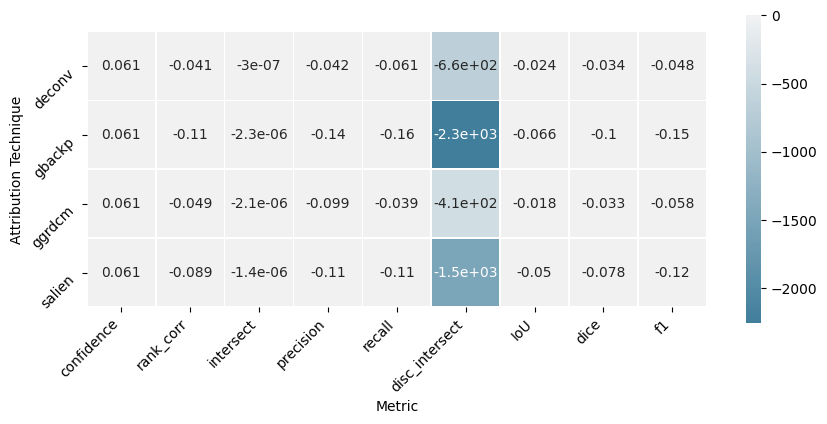

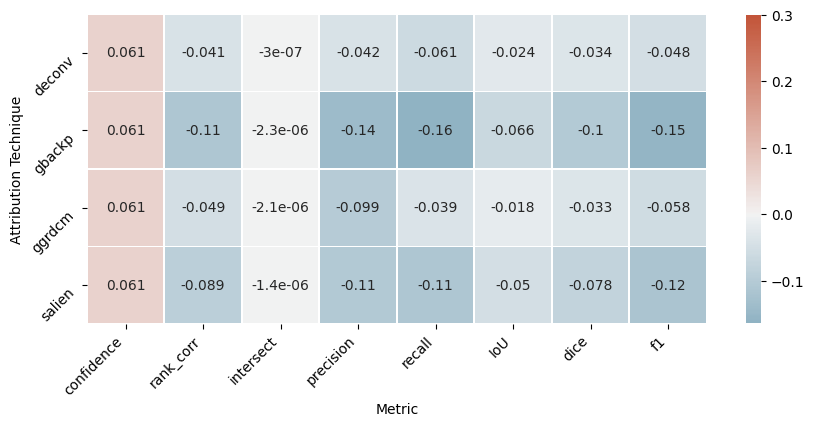

In [548]:
# high confidence difference
match_df = df.loc[(df['confidence'] > 0.75) & (df['mismatch']==False)].dropna().groupby('att_type').mean()
mismatch_df = df.loc[(df['confidence'] > 0.75) & (df['mismatch']==True)&(df['on_prediction'] == True)].dropna().groupby('att_type').mean()
print('mean')
display(match_df - mismatch_df)

match_std = df.loc[(df['confidence'] > 0.75) & (df['mismatch']==False)].dropna().groupby('att_type').std()
mismatch_std = df.loc[(df['confidence'] > 0.75) & (df['mismatch']==True)&(df['on_prediction'] == True)].dropna().groupby('att_type').std()
print('std')
display(match_std + mismatch_std)

diff_df = match_df - mismatch_df
plot_diff(diff_df)

mean


,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
att_type,,,,,,,,,
deconv,0.027691,0.126750,0.000002,0.148640,0.205222,3707.600,0.084708,0.124415,0.177689
gbackp,0.026777,0.150790,0.000002,0.221293,0.212623,4066.000,0.089929,0.146062,0.223281
ggrdcm,0.026777,0.136534,0.000003,0.322332,0.103846,1925.200,0.051045,0.089727,0.158029
salien,0.027691,0.098489,0.000001,0.129922,0.062395,2286.475,0.037660,0.058653,0.098935


std


,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
att_type,,,,,,,,,
deconv,0.117129,0.505668,0.000008,0.517727,0.819210,13457.602241,0.303025,0.449065,0.624085
gbackp,0.118981,0.281990,0.000007,0.478447,0.304748,6490.416875,0.132813,0.216658,0.344424
ggrdcm,0.118981,0.265420,0.000010,0.674491,0.194773,3054.360599,0.093459,0.164831,0.286633
salien,0.117129,0.313166,0.000005,0.385275,0.471816,8188.476425,0.181914,0.280462,0.405130


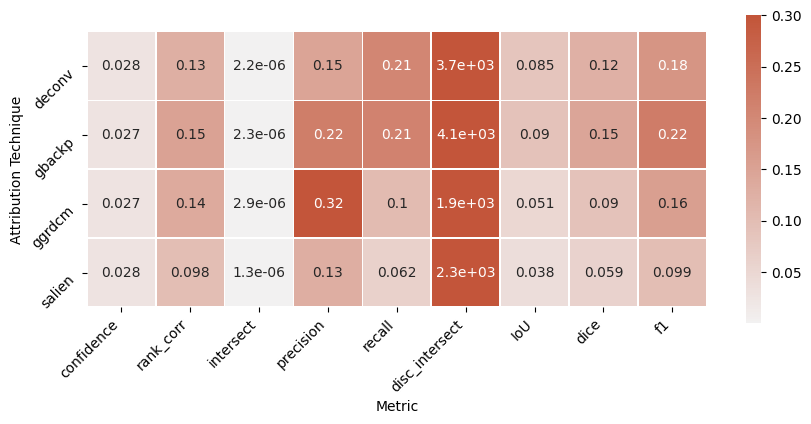

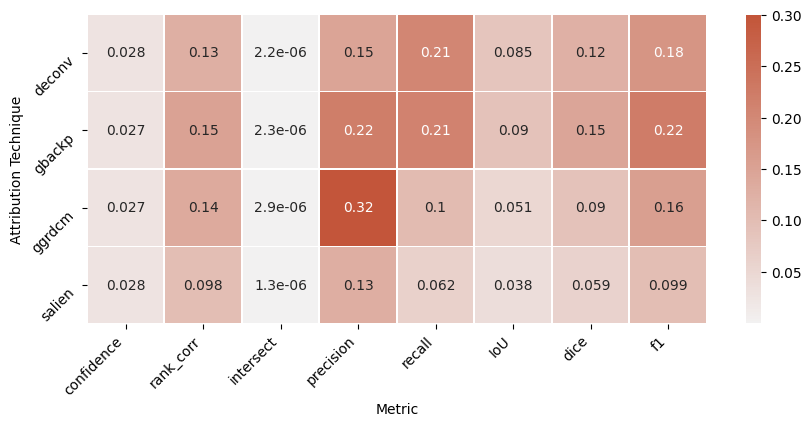

In [549]:
# low confidence difference
print('mean')
match_df = df.loc[(df['confidence'] < 0.25) & (df['mismatch']==False)].dropna().groupby('att_type').mean()
mismatch_df = df.loc[(df['confidence'] < 0.25) & (df['mismatch']==True)&(df['on_prediction'] == True)].dropna().groupby('att_type').mean()
display(match_df - mismatch_df)

print('std')
match_std = df.loc[(df['confidence'] < 0.25) & (df['mismatch']==False)].dropna().groupby('att_type').std()
mismatch_std = df.loc[(df['confidence'] < 0.25) & (df['mismatch']==True)&(df['on_prediction'] == True)].dropna().groupby('att_type').std()
display(match_std + mismatch_std)

diff_df = match_df - mismatch_df
plot_diff(diff_df)

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
count,66.000000,66.000000,66.000000,66.000000,66.000000,66.000000,66.000000,66.000000,66.000000
mean,0.453366,0.107166,0.000007,0.293155,0.336371,5546.272727,0.123375,0.210077,0.307469
std,0.250325,0.154623,0.000003,0.180839,0.211486,3123.651899,0.085209,0.128700,0.187688
min,0.033164,-0.115427,0.000002,0.000157,0.000068,1.000000,0.000028,0.000056,0.000094
25%,0.261679,-0.021147,0.000005,0.162737,0.173994,2840.250000,0.058905,0.111255,0.169935
50%,0.418468,0.082366,0.000006,0.276671,0.309059,5998.000000,0.114802,0.205959,0.308698
75%,0.653440,0.206596,0.000008,0.402816,0.447945,7880.000000,0.174993,0.297854,0.430608
max,0.916299,0.563367,0.000014,0.847042,0.896202,11853.000000,0.378707,0.549366,0.829678


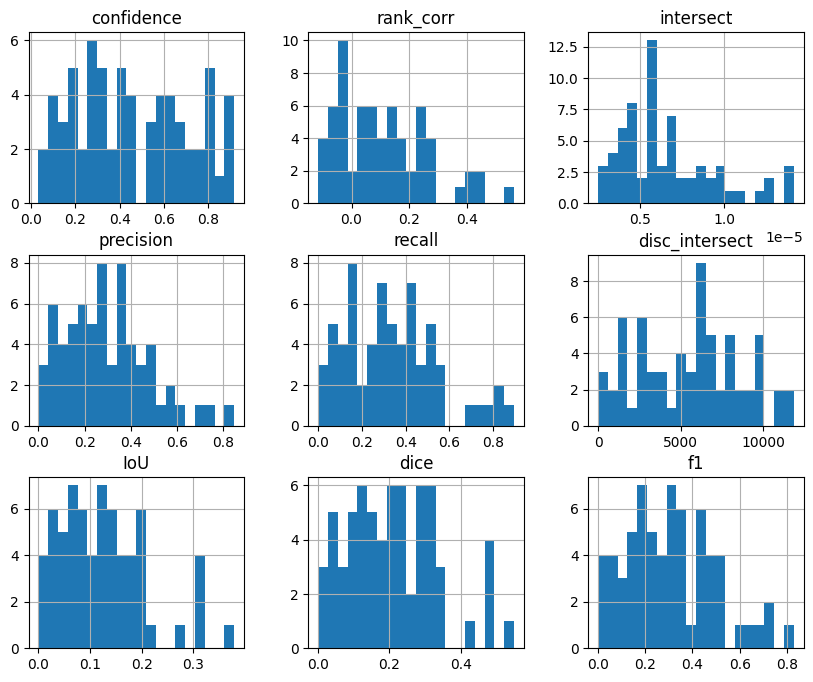

pearson


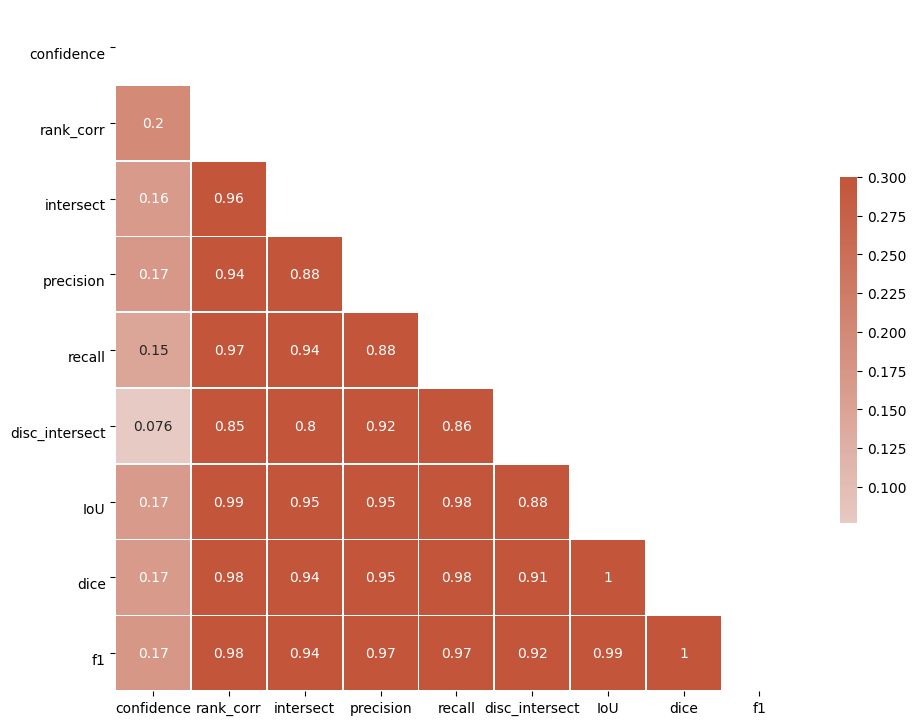

spearman


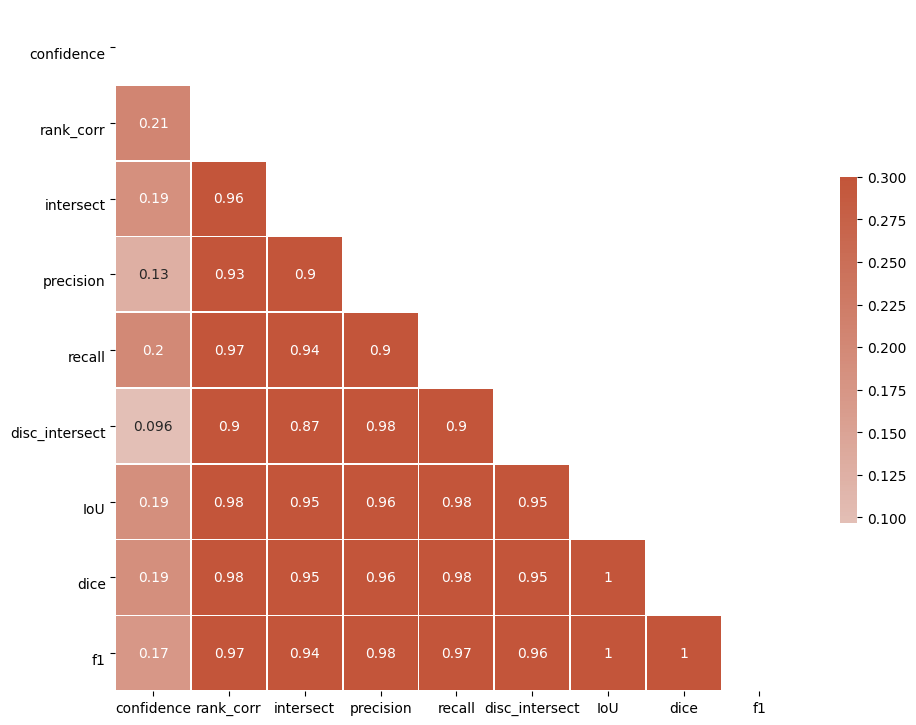

In [550]:
# high confidence mismatch corr
sub_df = df.loc[(df['att_type'] == 'salien') & (df['mismatch']==True) &(df['on_prediction']==True) &df['confidence']>0.75]
plot_histograms(sub_df)
plot_corr(sub_df)

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
count,114.000000,109.000000,114.000000,114.000000,114.000000,114.000000,114.000000,114.000000,114.000000
mean,0.735383,0.107104,0.000007,0.278466,0.303073,4895.780702,0.109790,0.188657,0.277398
std,0.226682,0.144319,0.000003,0.199496,0.213845,3517.699876,0.080424,0.128451,0.189877
min,0.086366,-0.154582,0.000002,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.598506,-0.011032,0.000004,0.125355,0.115441,1751.250000,0.038999,0.075070,0.108470
50%,0.815789,0.093072,0.000006,0.263319,0.293629,4630.500000,0.097711,0.178026,0.256722
75%,0.915060,0.207459,0.000008,0.395415,0.461036,7485.500000,0.162948,0.280233,0.422501
max,0.999796,0.486183,0.000022,0.917795,1.021060,14969.000000,0.329214,0.495352,0.729916


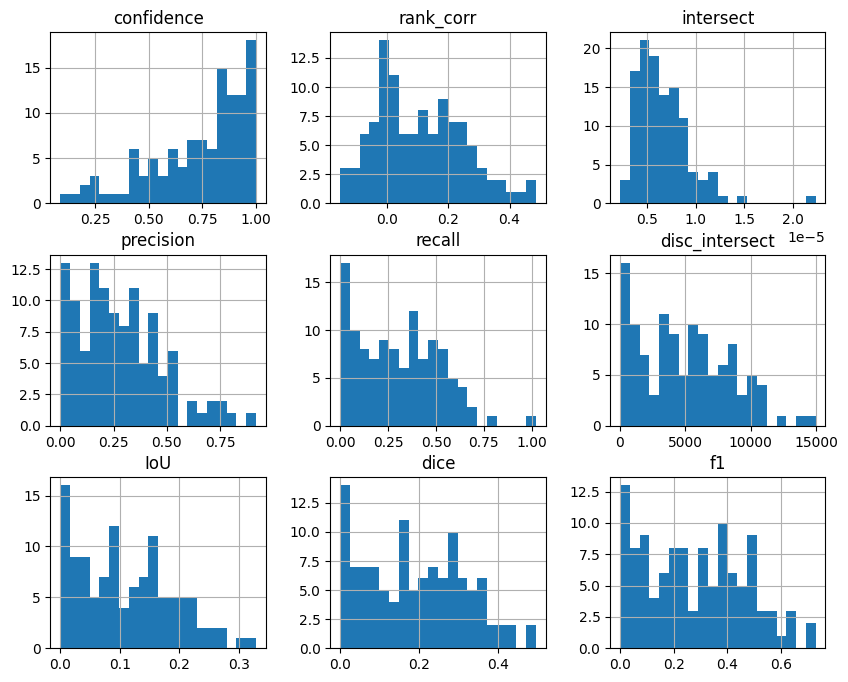

pearson


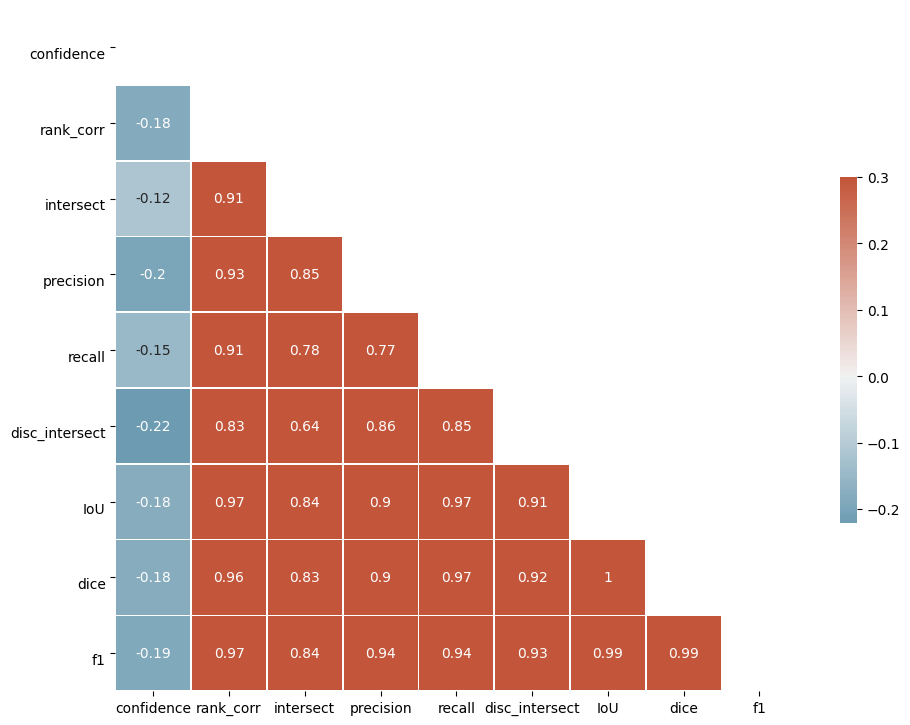

spearman


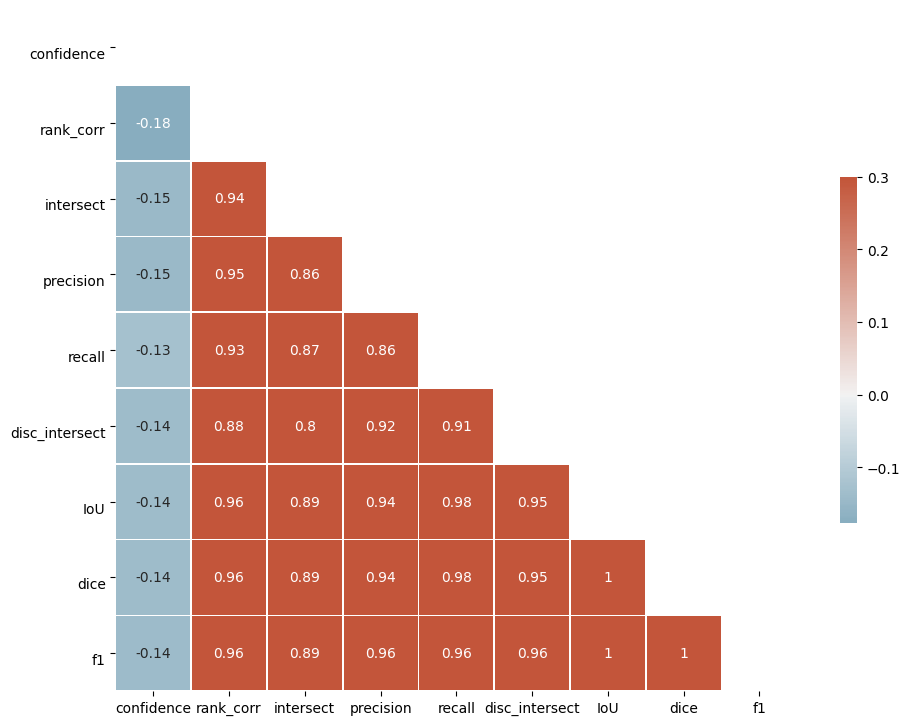

In [551]:
# high confidence match corr
sub_df = df.loc[(df['att_type'] == 'salien') & (df['mismatch']==False) &df['confidence']>0.75]
plot_histograms(sub_df)
plot_corr(sub_df)

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
count,918.000000,886.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000,918.000000
mean,0.593453,0.090783,0.000007,0.298913,0.219370,3444.311547,0.084086,0.142057,0.216514
std,0.276269,0.166866,0.000004,0.277331,0.261356,3973.725140,0.096479,0.147927,0.213110
min,0.033164,-0.194454,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.373645,-0.043960,0.000004,0.035283,0.017074,302.000000,0.006217,0.012357,0.020873
50%,0.621984,0.058645,0.000006,0.244602,0.122941,1936.500000,0.050702,0.096510,0.160303
75%,0.845568,0.205902,0.000009,0.485357,0.339269,5232.000000,0.130512,0.230890,0.357021
max,0.999796,0.685191,0.000022,1.000000,1.485394,19785.000000,0.553566,0.712639,0.965012


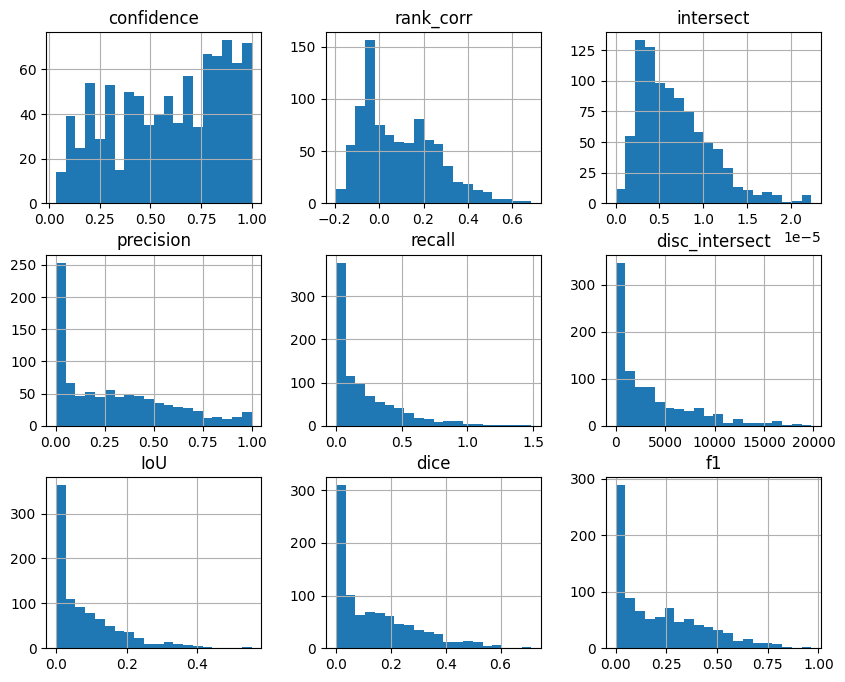

pearson


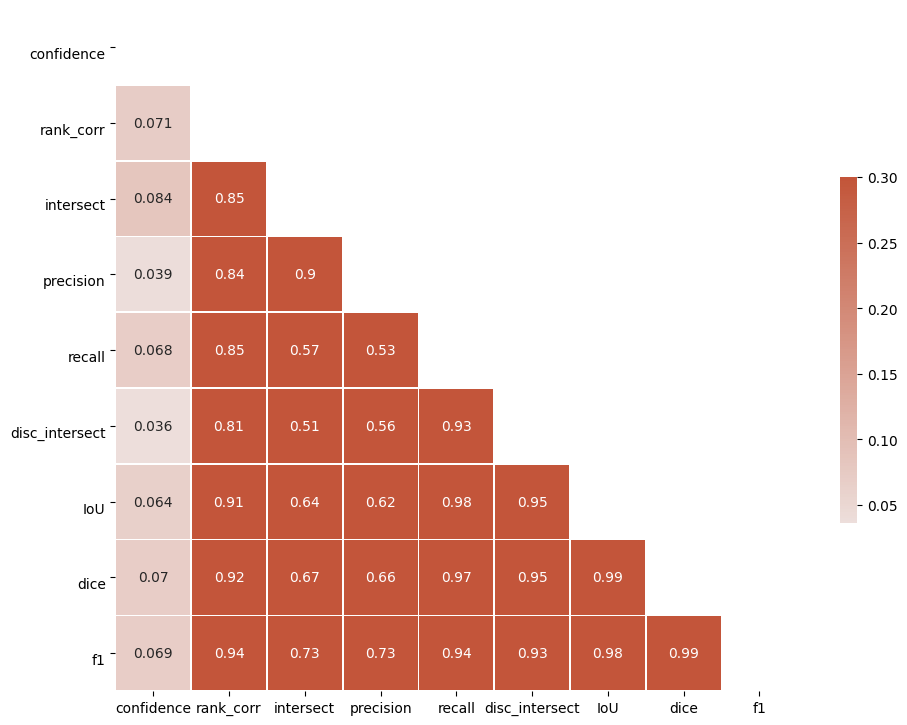

spearman


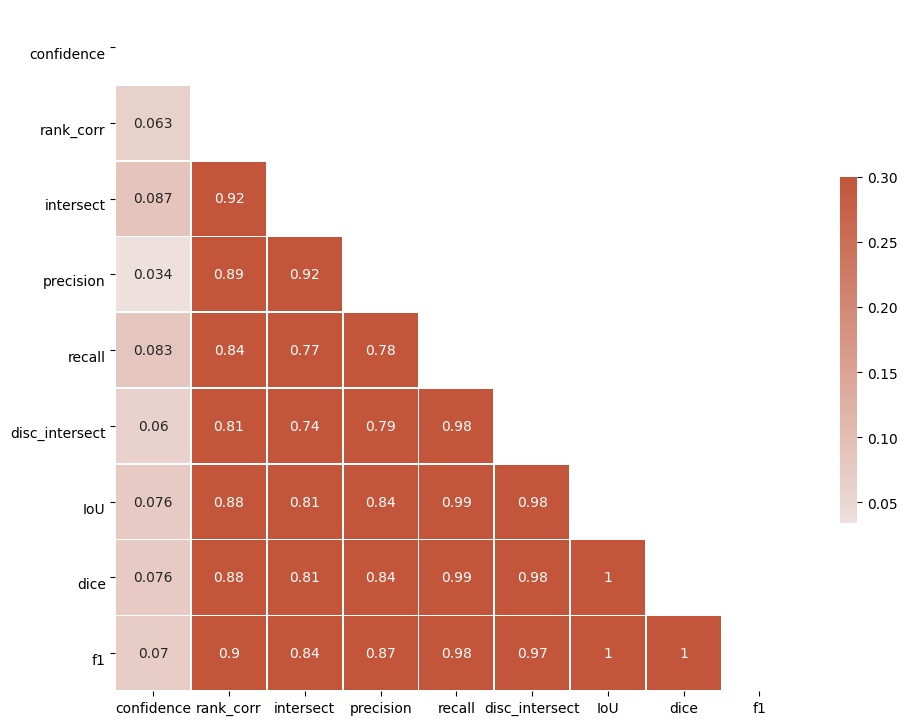

In [552]:
# low confidence mismatch corr
sub_df = df.loc[(df['att_type'] == 'salien') & (df['mismatch']==True) &(df['on_prediction']==True) &df['confidence']<0.25]
plot_histograms(sub_df)
plot_corr(sub_df)

,confidence,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
count,870.000000,843.000000,870.000000,870.000000,870.000000,870.000000,870.000000,870.000000,870.000000
mean,0.564228,0.089955,0.000007,0.301155,0.217278,3413.578161,0.083698,0.141111,0.215436
std,0.276656,0.168601,0.000004,0.279954,0.263809,3980.161385,0.097748,0.149165,0.214504
min,0.033164,-0.194454,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.312164,-0.046116,0.000004,0.031843,0.016843,299.500000,0.006124,0.012173,0.020645
50%,0.588915,0.057137,0.000006,0.248182,0.119904,1904.500000,0.048479,0.092475,0.156213
75%,0.820305,0.205477,0.000009,0.491032,0.323227,5170.000000,0.124819,0.221936,0.350788
max,0.999796,0.685191,0.000022,1.000000,1.485394,19785.000000,0.553566,0.712639,0.965012


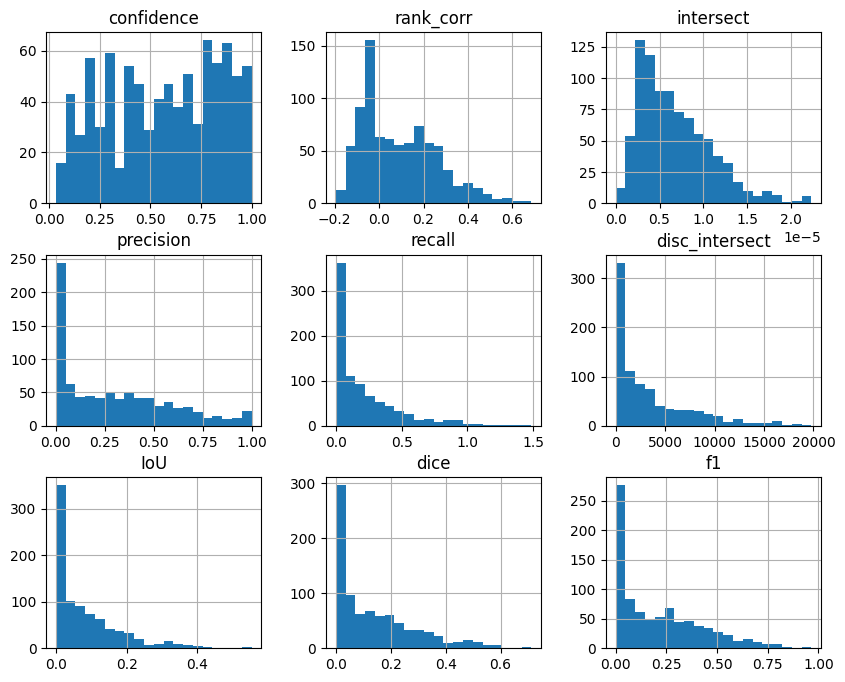

pearson


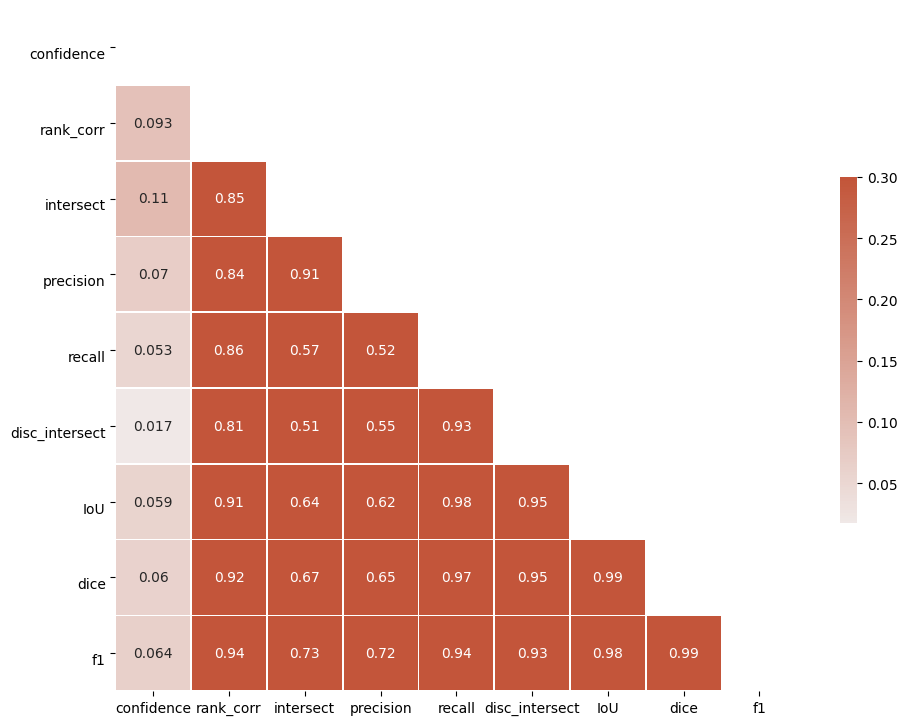

spearman


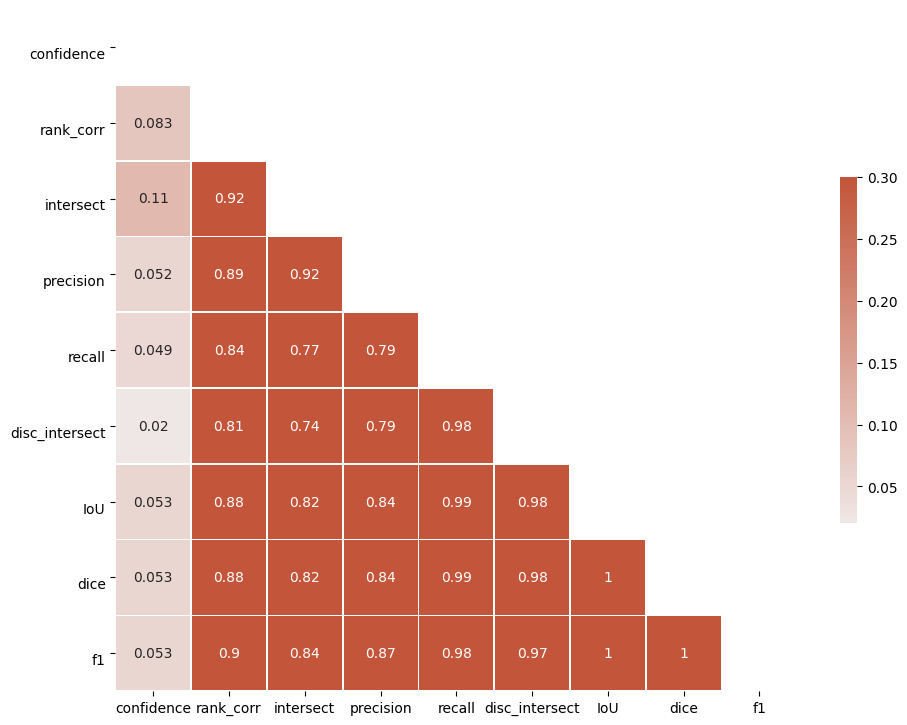

In [553]:
# low confidence match corr
sub_df = df.loc[(df['att_type'] == 'salien') & (df['mismatch']==False) &df['confidence']<0.25]
plot_histograms(sub_df)
plot_corr(sub_df)

In [517]:
# match_df = df.loc[(df['confidence'] < 0.25) & True &~df['mismatch']].dropna().groupby('att_type').agg([np.mean, np.std])
# mismatch_df = df.loc[(df['confidence'] < 0.25) & True &df['mismatch']&(~df['on_prediction'])].dropna().groupby('att_type').agg([np.mean, np.std])
sub_df = df.loc[(df['confidence'] < 0.25) & True &(df['mismatch']==False)]
# sub_df['answer'] == sub_df['prediction']
sub_df

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
17,3219710,model_data/val2014/COCO_val2014_000000321971.jpg,How many bottles of wine are on the table?,4,deconv,4,0.132409,4,False,True,"[[-0.9103532, -0.91442776, -0.8958295, -0.8951...",0.451278,0.000011,0.678631,0.839496,16562.0,0.350148,0.518681,0.750540
37,4292930,model_data/val2014/COCO_val2014_000000429293.jpg,What is the green food?,pickle,deconv,pickle,0.218102,pickle,False,True,"[[-0.8701445, -0.6725262, -0.9457649, -0.61657...",-0.098400,0.000003,0.011189,0.009562,140.0,0.003361,0.006699,0.010311
72,1073600,model_data/val2014/COCO_val2014_000000107360.jpg,What color is the board?,white,deconv,white,0.200877,white,False,True,"[[-0.7308427, -0.73124194, -0.73016566, -0.729...",0.417206,0.000010,0.533488,0.924337,13597.0,0.329145,0.495274,0.676518
187,4326192,model_data/val2014/COCO_val2014_000000432619.jpg,Why is the tooth shaped item being used as a v...,decoration,deconv,decoration,0.086366,decoration,False,True,"[[-1.0562673, -0.99661607, -1.1182619, -1.0591...",-0.149354,0.000002,0.010442,0.005104,134.0,0.002055,0.004102,0.006856
230,5759090,model_data/val2014/COCO_val2014_000000575909.jpg,What time of day is this picture?,afternoon,deconv,afternoon,0.226368,afternoon,False,True,"[[-1.1620644, -1.0113233, -1.1625619, -1.25655...",-0.145363,0.000004,0.016319,0.017784,330.0,0.005789,0.011511,0.017019
263,3219710,model_data/val2014/COCO_val2014_000000321971.jpg,How many bottles of wine are on the table?,4,ggrdcm,4,0.132409,4,False,True,"[[-0.2360713, -0.2360713, -0.2360713, -0.23607...",0.147015,0.000009,0.571579,0.137821,2719.0,0.065526,0.122993,0.222090
283,4292930,model_data/val2014/COCO_val2014_000000429293.jpg,What is the green food?,pickle,ggrdcm,pickle,0.218102,pickle,False,True,"[[-0.20936939, -0.20936939, -0.20936939, -0.20...",0.333732,0.000017,0.879960,0.302896,4435.0,0.148382,0.258420,0.450665
318,1073600,model_data/val2014/COCO_val2014_000000107360.jpg,What color is the board?,white,ggrdcm,white,0.200877,white,False,True,"[[-0.2556556, -0.25574008, -0.2556887, -0.2555...",0.256481,0.000011,0.686966,0.256900,3779.0,0.121347,0.216431,0.373954
335,5759090,model_data/val2014/COCO_val2014_000000575909.jpg,What time of day is this picture?,afternoon,ggrdcm,afternoon,0.226368,afternoon,False,True,"[[-0.1881802, -0.1881802, -0.1881802, -0.18818...",-0.046564,0.000005,0.070255,0.018430,342.0,0.008213,0.016293,0.029200
463,4326192,model_data/val2014/COCO_val2014_000000432619.jpg,Why is the tooth shaped item being used as a v...,decoration,ggrdcm,decoration,0.086366,decoration,False,True,"[[-0.17388996, -0.17360565, -0.17252861, -0.17...",0.251849,0.000010,0.988779,0.171187,4494.0,0.085510,0.157549,0.291846


In [512]:
sub_df

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
3,3547360,model_data/val2014/COCO_val2014_000000354736.jpg,Which skier is moving away from the other skiers?,one in front,deconv,right,0.131426,one in front,True,False,"[[-0.86764705, -0.84766084, -0.9381518, -0.886...",0.084236,0.000005,0.226440,0.397179,5942.0,0.118319,0.211602,0.288436
4,3547360,model_data/val2014/COCO_val2014_000000354736.jpg,Which skier is moving away from the other skiers?,one in front,deconv,right,0.131426,right,True,True,"[[-0.7284996, -0.6756967, -0.9145558, -0.77745...",-0.036968,0.000003,0.001266,0.000134,2.0,0.000063,0.000127,0.000242
17,3219710,model_data/val2014/COCO_val2014_000000321971.jpg,How many bottles of wine are on the table?,4,deconv,4,0.132409,4,False,True,"[[-0.9103532, -0.91442776, -0.8958295, -0.8951...",0.451278,0.000011,0.678631,0.839496,16562.0,0.350148,0.518681,0.750540
22,4153602,model_data/val2014/COCO_val2014_000000415360.jpg,What is the black dog resting on?,skateboard,deconv,chair,0.198249,skateboard,True,False,"[[-1.1653143, -1.1689118, -1.1583686, -1.13530...",-0.029253,0.000004,0.162703,0.146671,2942.0,0.053242,0.101101,0.154271
23,4153602,model_data/val2014/COCO_val2014_000000415360.jpg,What is the black dog resting on?,skateboard,deconv,chair,0.198249,chair,True,True,"[[-1.1173972, -1.1193379, -1.1143459, -1.10323...",-0.113803,0.000004,0.038300,0.028168,565.0,0.010404,0.020595,0.032461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
961,5399371,model_data/val2014/COCO_val2014_000000539937.jpg,Is the photographer seeing what the boy is see...,yes,salien,very,0.120915,very,True,True,"[[-0.009833532, -0.31967616, -0.41149062, -0.4...",-0.031118,0.000005,0.113706,0.173596,2522.0,0.051772,0.098446,0.137408
965,4080472,model_data/val2014/COCO_val2014_000000408047.jpg,Where are the yellow cabs?,road,salien,yes,0.121110,road,True,False,"[[-0.033588815, 0.58426654, 1.2654458, 1.05879...",-0.046010,0.000004,0.127564,0.132016,2419.0,0.045478,0.086999,0.129752
966,4080472,model_data/val2014/COCO_val2014_000000408047.jpg,Where are the yellow cabs?,road,salien,yes,0.121110,yes,True,True,"[[-0.2427695, 0.09717985, 0.49715906, 0.226757...",-0.079217,0.000003,0.085861,0.085573,1568.0,0.029396,0.057113,0.085717
970,885600,model_data/val2014/COCO_val2014_000000088560.jpg,What is the total number of oranges on the shelf?,10,salien,4,0.085607,10,True,False,"[[-0.30124047, 0.11908363, -0.14873052, -0.232...",-0.010641,0.000004,0.156071,0.200964,3378.0,0.065107,0.122254,0.175695


In [460]:
display(diff_df)

confidence           rank_corr               intersect                \
               mean       std      mean       std          mean           std   
att_type                                                                        
deconv     0.004106 -0.008891 -0.035991 -0.059362 -9.396388e-07 -1.104225e-06   
gbackp    -0.001720 -0.006626 -0.065831 -0.007531 -1.733613e-06  1.138389e-07   
ggrdcm    -0.001720 -0.006626 -0.088983 -0.030616 -2.689524e-06 -1.947284e-07   
salien     0.004106 -0.008891 -0.038434 -0.029639 -8.128718e-07 -4.381716e-07   

         precision              recall                 IoU            \
              mean       std      mean       std      mean       std   
att_type                                                               
deconv   -0.023646 -0.028597 -0.080221 -0.113825 -0.030612 -0.039943   
gbackp   -0.110080  0.006677 -0.084837  0.026670 -0.037164  0.006284   
ggrdcm   -0.186902 -0.000785 -0.077516 -0.040475 -0.038606 -0.022020   
salien   -0.036917 -0.055947 -0.037498 -0.026785 -0.020574 -0.024464   

              dice                  f1            
              mean       std      mean       std  
att_type                                          
deconv   -0.037621 -0.050355 -0.047390 -0.061364  
gbackp   -0.061892  0.015937 -0.098431  0.020135  
ggrdcm   -0.064777 -0.028595 -0.111360 -0.042748  
salien   -0.027424 -0.028367 -0.041818 -0.046629

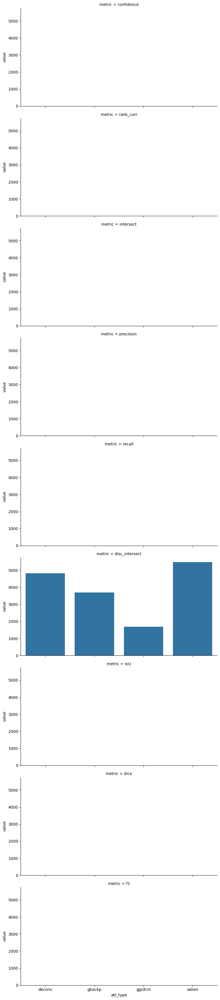

In [269]:
# nested barplot of means by att_type and metric
# sub_df = df_means.reset_index().melt(id_vars=['att_type'], var_name='metric')
# g = sns.catplot(
#     data=sub_df, kind='bar',
#     x='metric', y='value', hue='att_type',
#     ci='sd', palette='dark', alpha=.6, height=6
# )
# g.despine(left=True)
# g.set_axis_labels('','')
# g.legend.set_title('Attribution Technique')

# att_types = sub_df.att_type.unique()
# g = sns.FacetGrid(sub_df, row='metric',
#                   palette='set3', height=4, aspect=2)
# g.map(sns.barplot, 'att_type', 'value', order=att_types)

# plt.show()

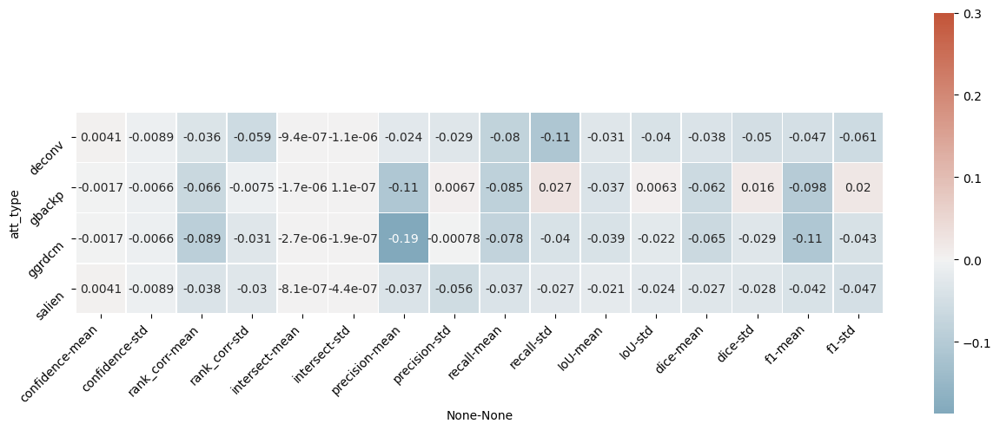

In [380]:
display(diff_df)
diff_df = diff_df.loc[:, (diff_df.columns != ('disc_intersect','mean'))&( diff_df.columns != ('disc_intersect','std'))]

f, ax = plt.subplots(figsize=(15, 12))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
plot = sns.heatmap(diff_df, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
plot.set_yticklabels(plot.get_yticklabels(), rotation=45, verticalalignment='top')
plt.show()

In [ ]:
# high confidence difference
match_df = df.loc[(df['confidence'] > 0.75) & True &~df['mismatch']].dropna().groupby('att_type').agg([np.mean, np.std])
mismatch_df = df.loc[(df['confidence'] > 0.75) & True &df['mismatch']&(~df['on_prediction'])].dropna().groupby('att_type').agg([np.mean, np.std])
diff_df = match_df - mismatch_df

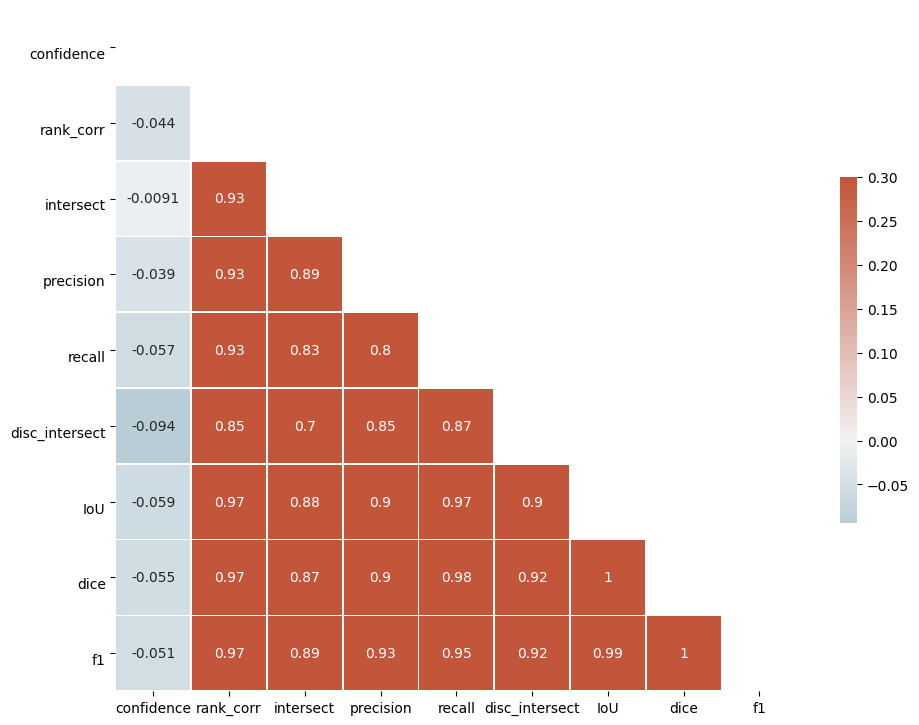

In [459]:
# examine means with correct and incorrect predictions and low and high correlation
# (e.g. ask do correct predictions generally have higher IoU?)

# high conf, match
sub_df = df.loc[(df['att_type'] == 'salien') & (df['mismatch']) &df['on_prediction'] &df['confidence']>.75]
# corr, p = pearsonr(sub_df['confidence'], sub_df['IoU'])

# corr matrix
corr = sub_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
# mask = np.ndarray(len(corr))
# print(corr.iloc[:,0].shape)

# plot heatmap
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
plot = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
# plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
plot.set_yticklabels(plot.get_yticklabels(), rotation=0, verticalalignment='top')
plt.show()

Qualitatively check this

In [442]:
sub_df = df.loc[(df['confidence'] < 0.25) & (df['qid'] == 4015502)& True &(df['answer'] == df['prediction'])&df['on_prediction']].sort_values('confidence')
sub_df

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
880,4015502,model_data/val2014/COCO_val2014_000000401550.jpg,How many spokes are on the front wheel of the ...,6,deconv,6,0.061218,6,True,True,"[[-0.9811087, -0.96888405, -0.9498209, -0.9523...",0.467516,0.000012,0.633223,0.937988,16094.0,0.368807,0.538874,0.756048
1177,4015502,model_data/val2014/COCO_val2014_000000401550.jpg,How many spokes are on the front wheel of the ...,6,ggrdcm,6,0.061218,6,True,True,"[[-0.23378709, -0.23375879, -0.23314455, -0.23...",0.345248,0.000016,0.950460,0.300793,5161.0,0.149227,0.259699,0.456968
2835,4015502,model_data/val2014/COCO_val2014_000000401550.jpg,How many spokes are on the front wheel of the ...,6,gbackp,6,0.061218,6,True,True,"[[-0.34336406, -0.34205222, -0.3135914, -0.281...",0.323235,0.000014,0.845996,0.311516,5345.0,0.151464,0.263080,0.455358
3904,4015502,model_data/val2014/COCO_val2014_000000401550.jpg,How many spokes are on the front wheel of the ...,6,salien,6,0.061218,6,True,True,"[[-0.41497648, 0.37645867, -0.039660532, 0.498...",0.014465,0.000005,0.187857,0.207192,3555.0,0.071551,0.133546,0.197051


Question ID: 4015502
Question: How many spokes are on the front wheel of the motorcycle?
Answer: 6
HieCoAttentionVQA attention:


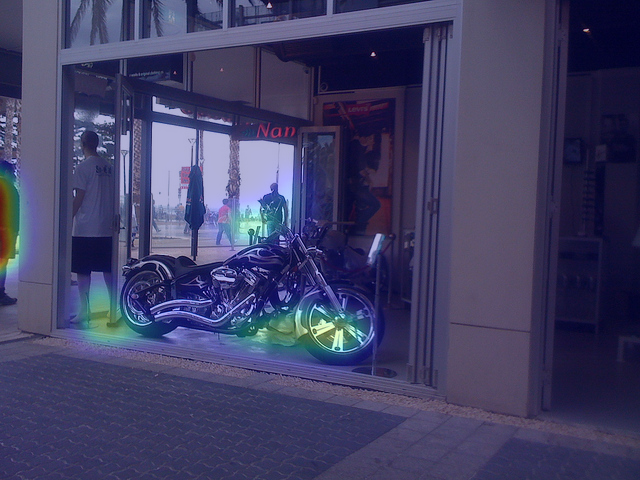

Rank correlation: 0.6256661182535757
Human attention:


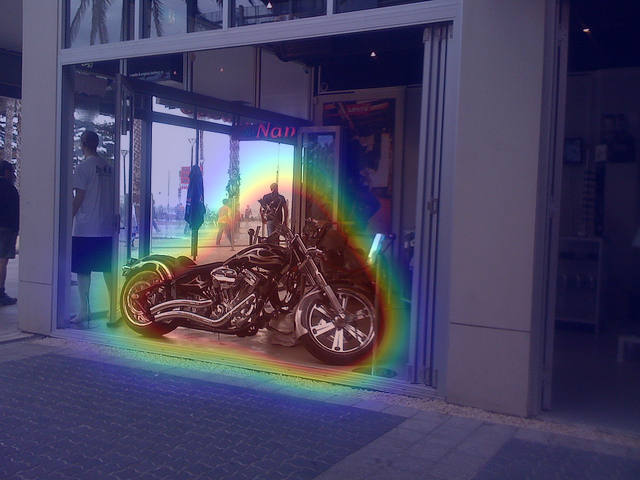

Question ID: 4015502
Question: How many spokes are on the front wheel of the motorcycle?
Answer: 6
HieCoAttentionVQA attention:


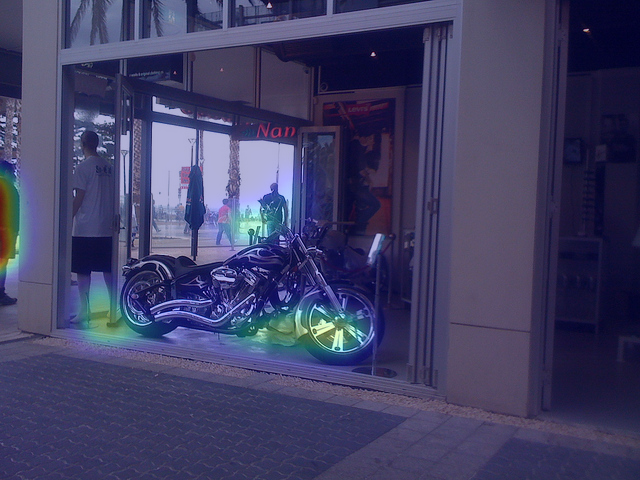

Rank correlation: 0.6256661182535757
Human attention:


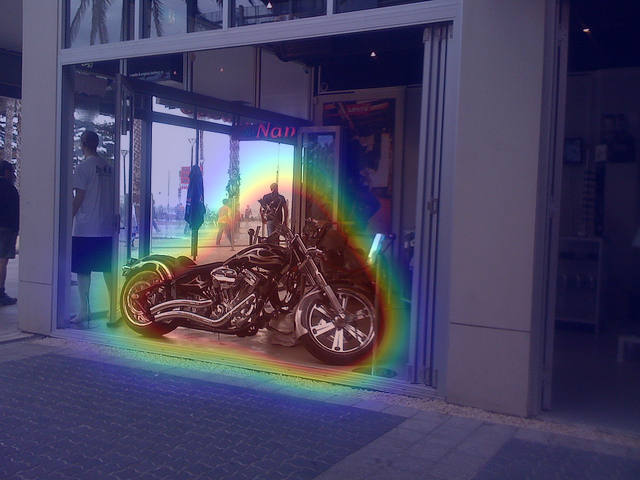

Question ID: 4015502
Question: How many spokes are on the front wheel of the motorcycle?
Answer: 6
HieCoAttentionVQA attention:


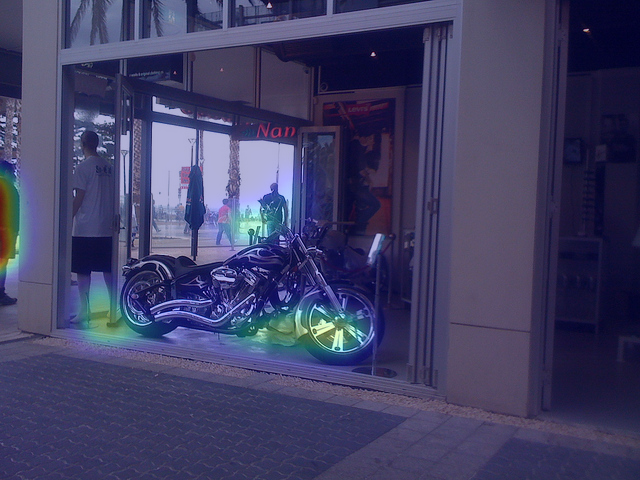

Rank correlation: 0.6256661182535757
Human attention:


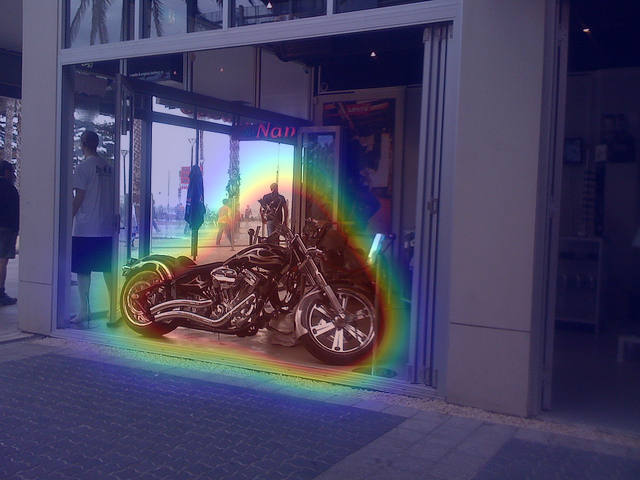

Question ID: 4015502
Question: How many spokes are on the front wheel of the motorcycle?
Answer: 6
HieCoAttentionVQA attention:


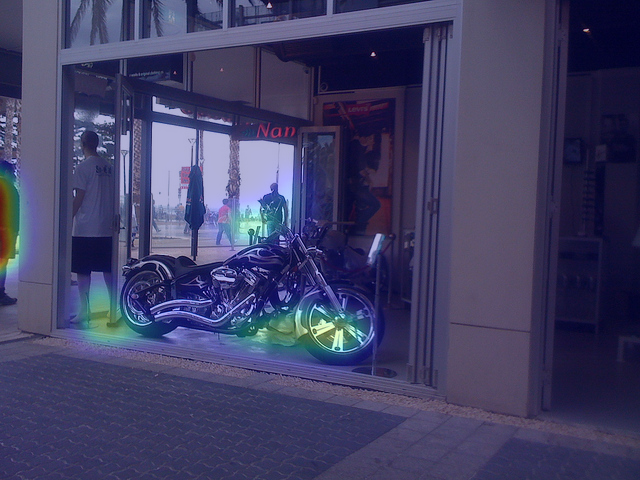

Rank correlation: 0.6256661182535757
Human attention:


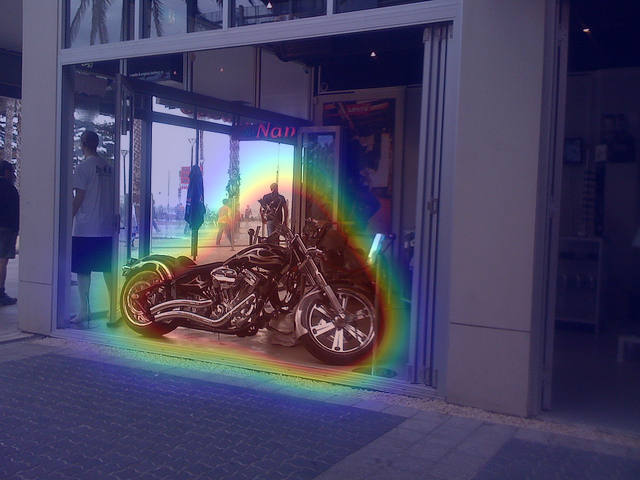

Question ID: 5530832
Question: How can you tell that someone owns this dog?
Answer: collar
HieCoAttentionVQA attention:


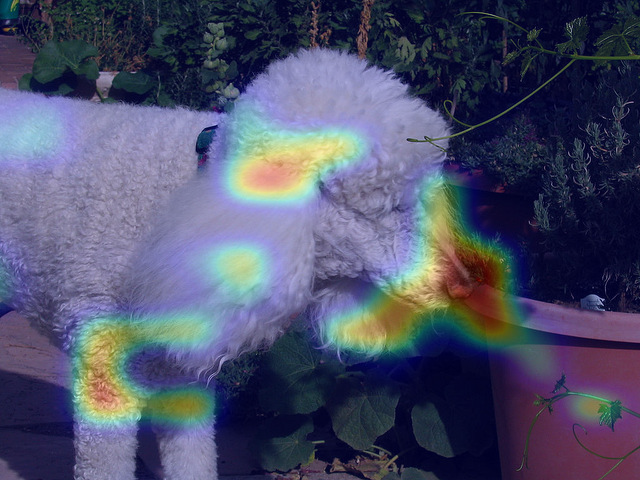

Rank correlation: 0.28865157089144683
Human attention:


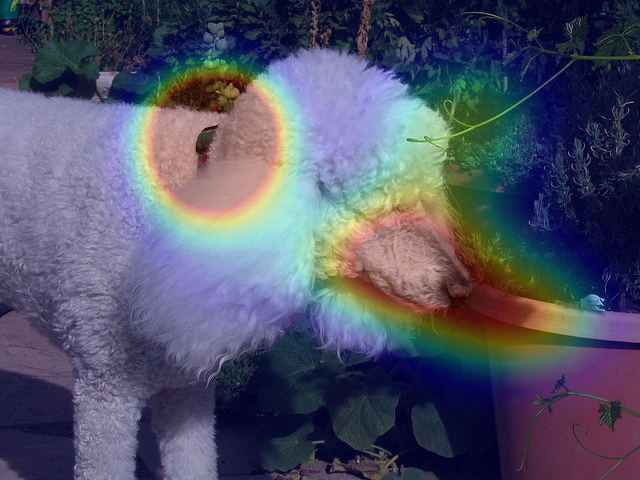

Question ID: 5530832
Question: How can you tell that someone owns this dog?
Answer: collar
HieCoAttentionVQA attention:


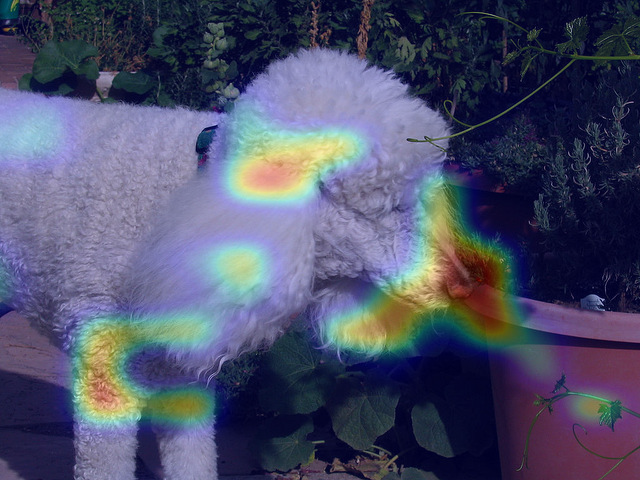

Rank correlation: 0.28865157089144683
Human attention:


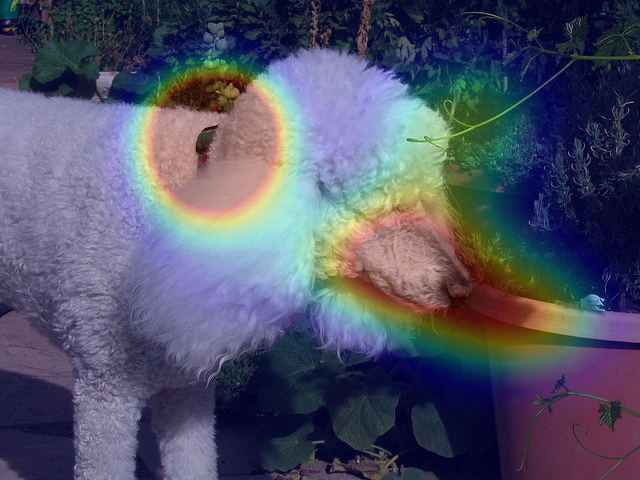

Question ID: 5530832
Question: How can you tell that someone owns this dog?
Answer: collar
HieCoAttentionVQA attention:


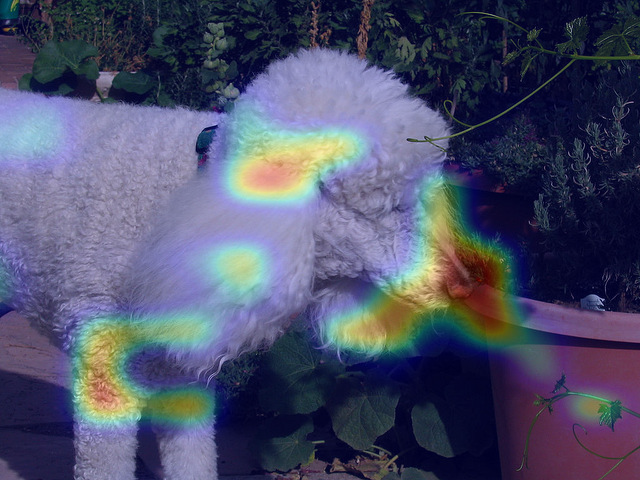

Rank correlation: 0.28865157089144683
Human attention:


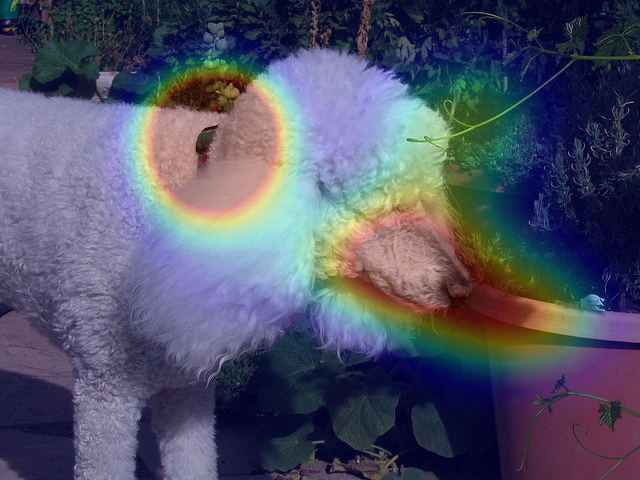

Question ID: 5530832
Question: How can you tell that someone owns this dog?
Answer: collar
HieCoAttentionVQA attention:


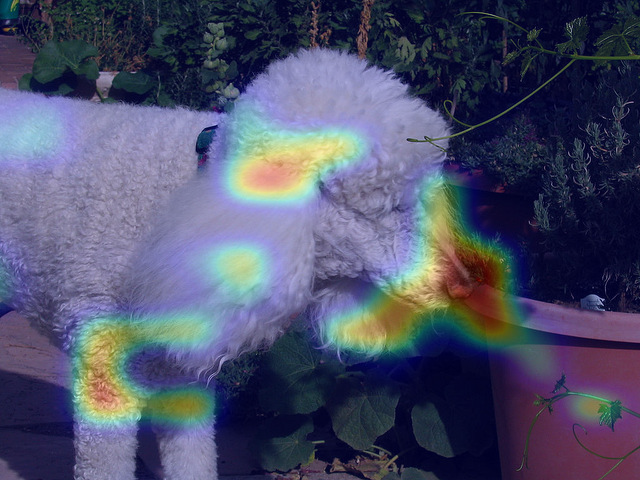

Rank correlation: 0.28865157089144683
Human attention:


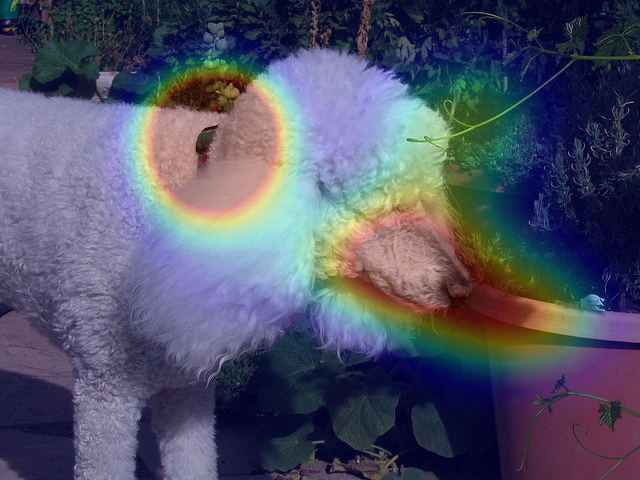

Question ID: 2664432
Question: What is the woman doing with her fingers?
Answer: cutting
HieCoAttentionVQA attention:


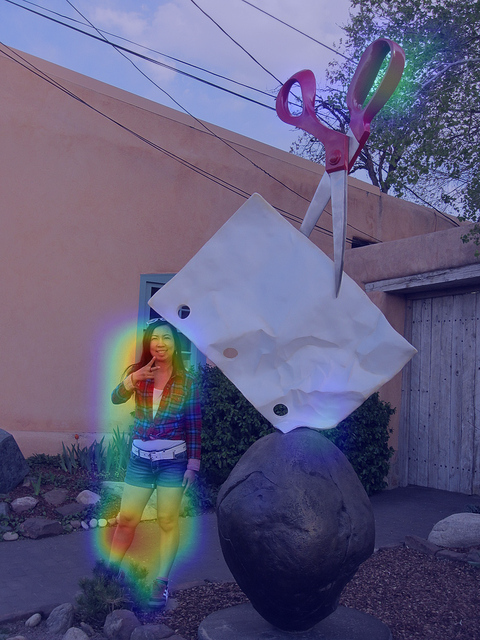

Rank correlation: 0.1876826544580531
Human attention:


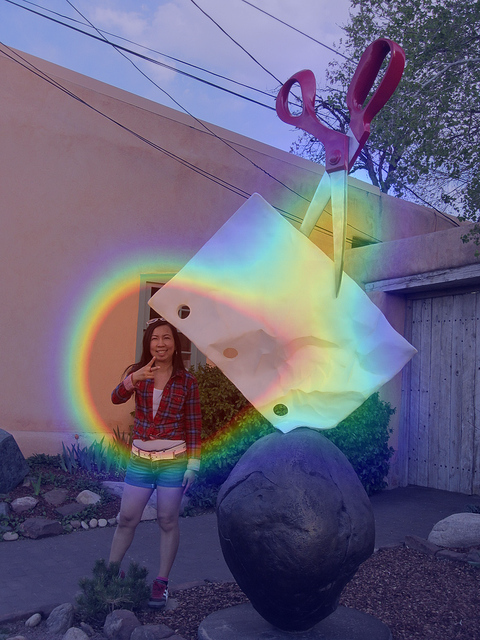

Question ID: 2664432
Question: What is the woman doing with her fingers?
Answer: cutting
HieCoAttentionVQA attention:


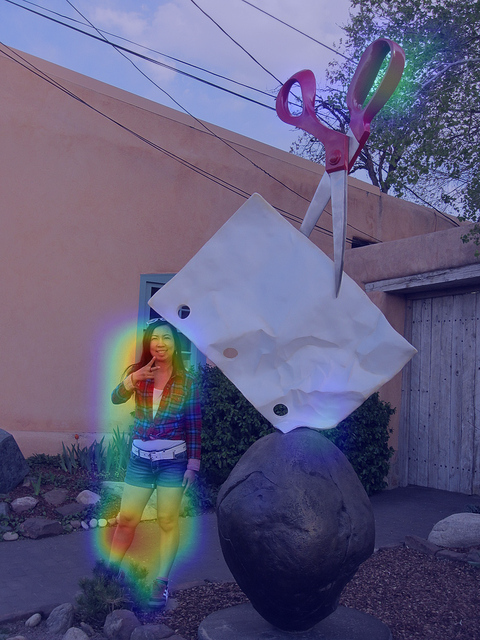

Rank correlation: 0.1876826544580531
Human attention:


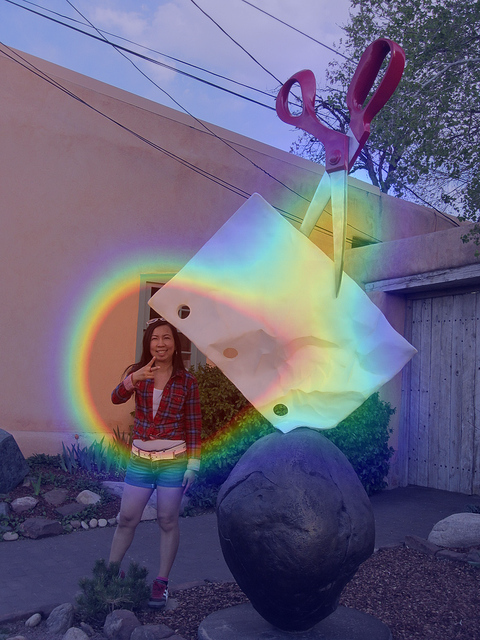

Question ID: 2664432
Question: What is the woman doing with her fingers?
Answer: cutting
HieCoAttentionVQA attention:


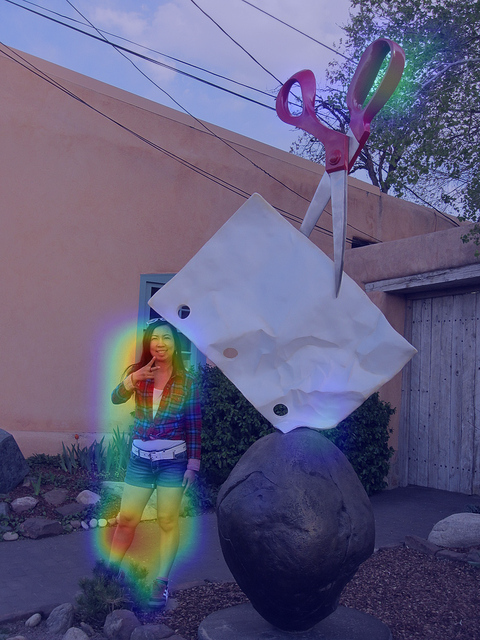

Rank correlation: 0.1876826544580531
Human attention:


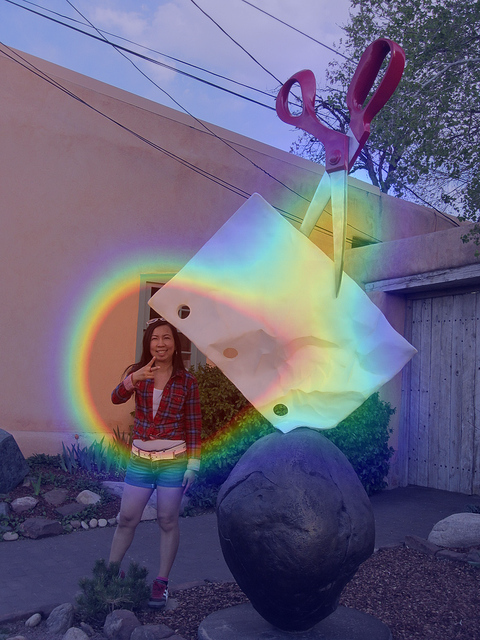

Question ID: 2664432
Question: What is the woman doing with her fingers?
Answer: cutting
HieCoAttentionVQA attention:


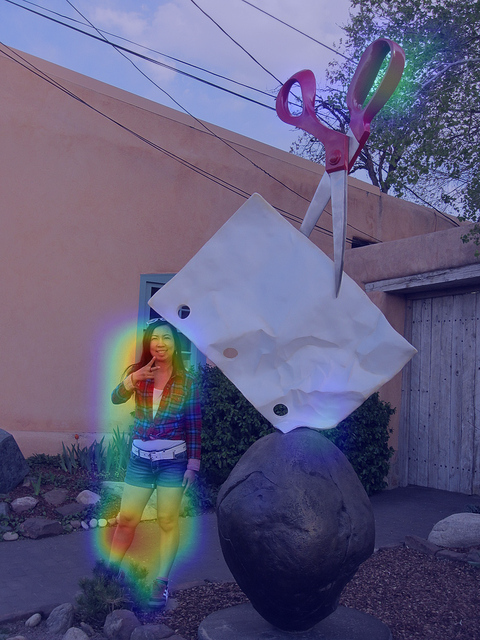

Rank correlation: 0.1876826544580531
Human attention:


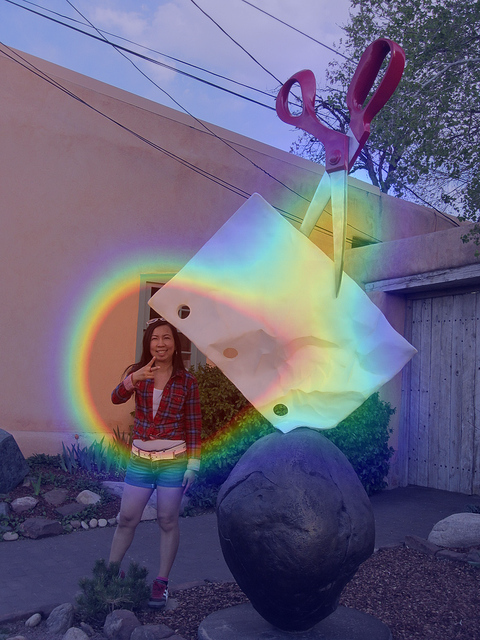

Question ID: 4326192
Question: Why is the tooth shaped item being used as a vase?
Answer: decoration
HieCoAttentionVQA attention:


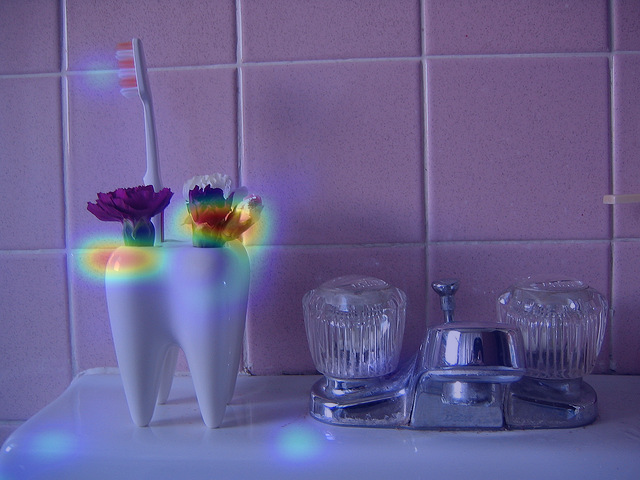

Rank correlation: 0.35353119028145485
Human attention:


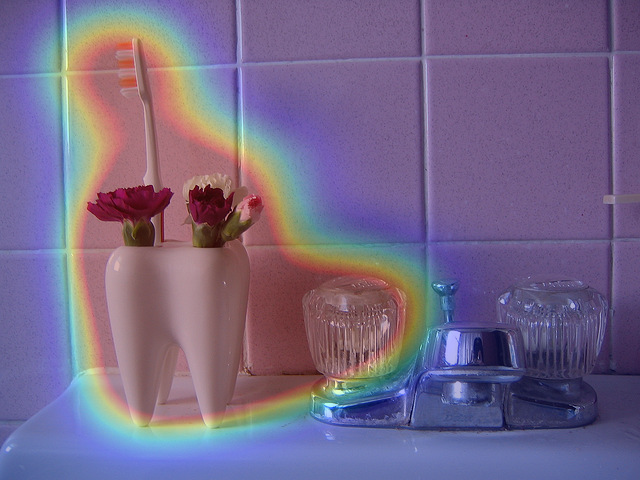

Question ID: 4326192
Question: Why is the tooth shaped item being used as a vase?
Answer: decoration
HieCoAttentionVQA attention:


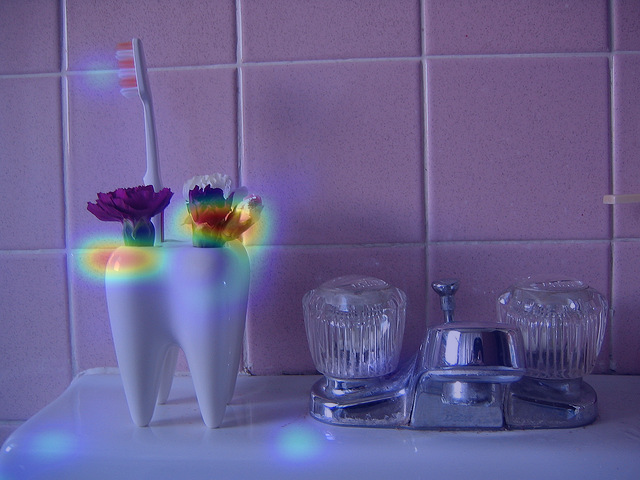

Rank correlation: 0.35353119028145485
Human attention:


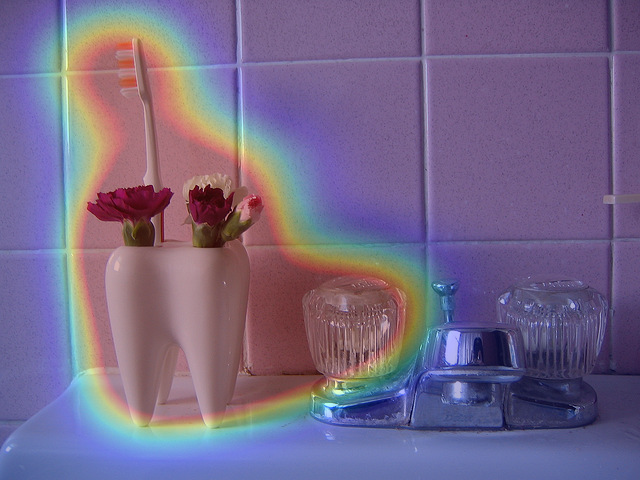

Question ID: 4326192
Question: Why is the tooth shaped item being used as a vase?
Answer: decoration
HieCoAttentionVQA attention:


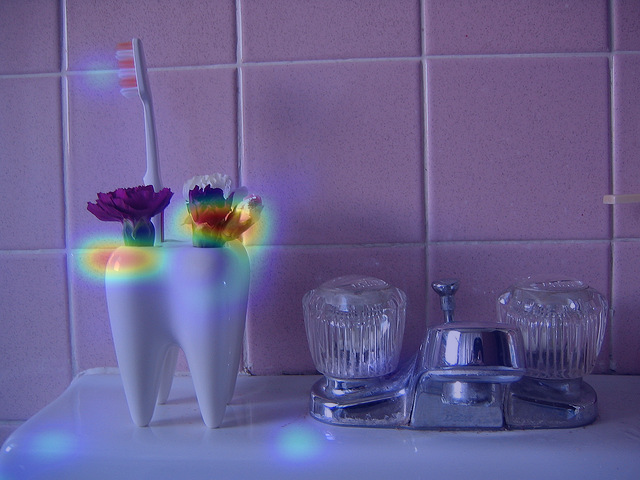

Rank correlation: 0.35353119028145485
Human attention:


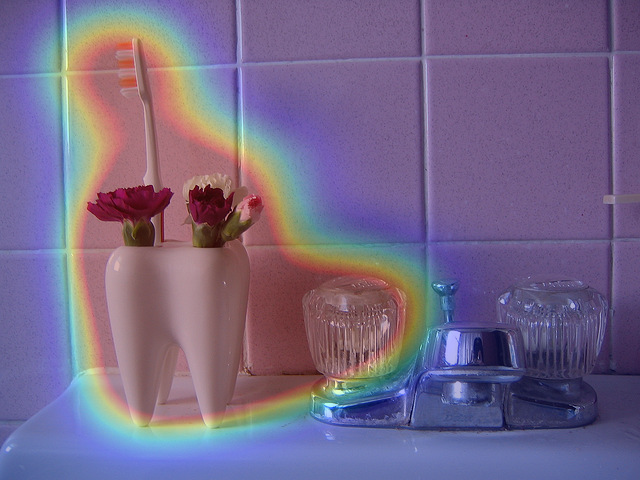

In [437]:
for i in range(0,15):
    compare_maps(sub_df.iloc[i]['qid'], sans2=False)

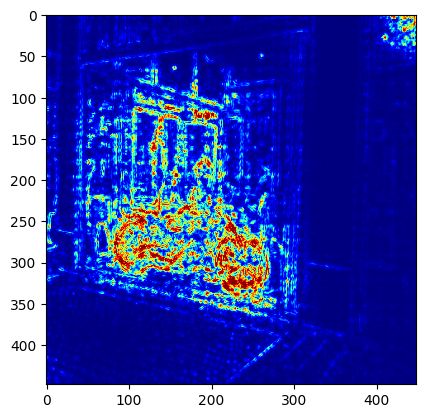

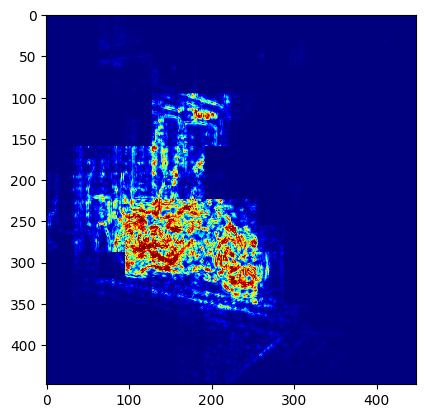

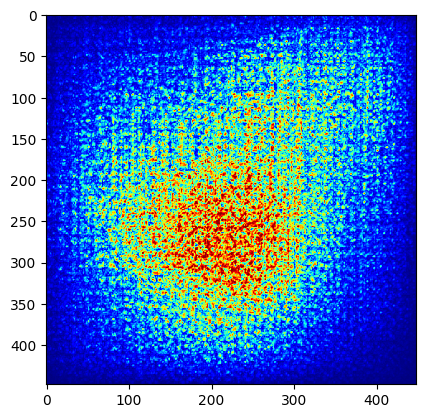

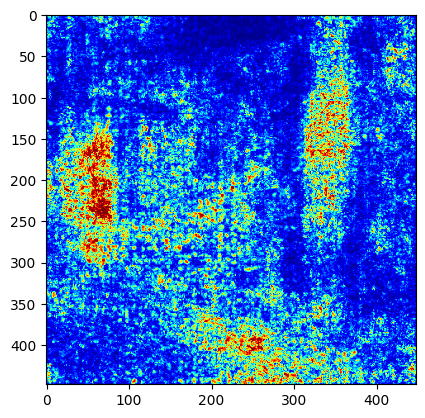

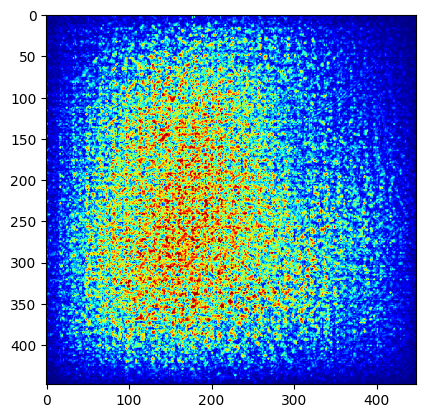

...

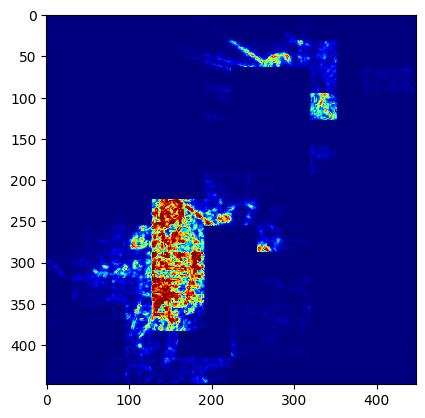

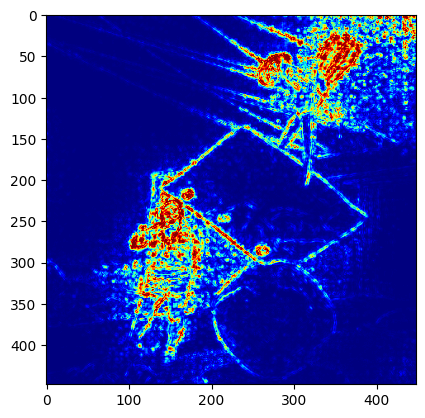

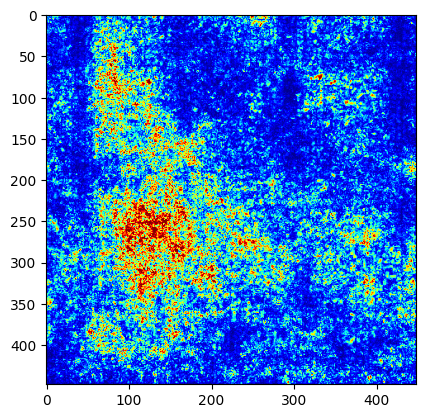

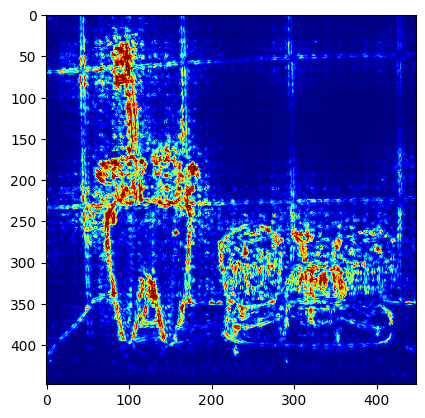

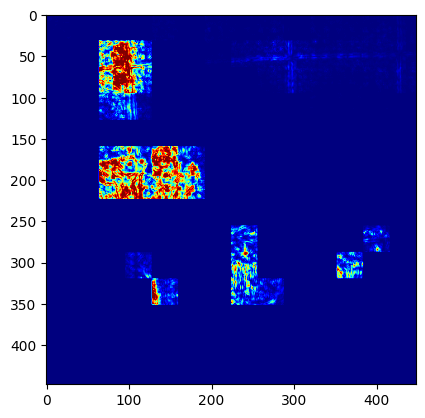

In [438]:
for i in range(0,15):
    display_mask(sub_df.iloc[i]['map'])

In [335]:
diff_df.columns

MultiIndex([(    'confidence', 'mean'),
            (    'confidence',  'std'),
            (     'rank_corr', 'mean'),
            (     'rank_corr',  'std'),
            (     'intersect', 'mean'),
            (     'intersect',  'std'),
            (     'precision', 'mean'),
            (     'precision',  'std'),
            (        'recall', 'mean'),
            (        'recall',  'std'),
            ('disc_intersect', 'mean'),
            ('disc_intersect',  'std'),
            (           'IoU', 'mean'),
            (           'IoU',  'std'),
            (          'dice', 'mean'),
            (          'dice',  'std'),
            (            'f1', 'mean'),
            (            'f1',  'std')],
           )

In [331]:
# examine means with correct and incorrect predictions: do correct predictions generally have higher IoU?

# when the model is correct, does confidence correlate with salien IoU?

match_df = df.loc[(df['confidence'] < 0.25) & True &~df['mismatch']].dropna().groupby('att_type').agg([np.mean, np.std])
mismatch_df = df.loc[(df['confidence'] < 0.25) & True &df['mismatch']&(~df['on_prediction'])].dropna().groupby('att_type').agg([np.mean, np.std])

match_df - mismatch_df

confidence           rank_corr               intersect                \
               mean       std      mean       std          mean           std   
att_type                                                                        
deconv     0.004106 -0.008891 -0.035991 -0.059362 -9.396388e-07 -1.104225e-06   
gbackp    -0.001720 -0.006626 -0.065831 -0.007531 -1.733613e-06  1.138389e-07   
ggrdcm    -0.001720 -0.006626 -0.088983 -0.030616 -2.689524e-06 -1.947284e-07   
salien     0.004106 -0.008891 -0.038434 -0.029639 -8.128718e-07 -4.381716e-07   

         precision              recall           disc_intersect              \
              mean       std      mean       std           mean         std   
att_type                                                                      
deconv   -0.023646 -0.028597 -0.080221 -0.113825    -642.453704 -725.674229   
gbackp   -0.110080  0.006677 -0.084837  0.026670   -1247.880295  754.455824   
ggrdcm   -0.186902 -0.000785 -0.077516 -0.040475   -1115.708287 -136.022876   
salien   -0.036917 -0.055947 -0.037498 -0.026785    -613.737654 -849.824508   

               IoU                dice                  f1            
              mean       std      mean       std      mean       std  
att_type                                                              
deconv   -0.030612 -0.039943 -0.037621 -0.050355 -0.047390 -0.061364  
gbackp   -0.037164  0.006284 -0.061892  0.015937 -0.098431  0.020135  
ggrdcm   -0.038606 -0.022020 -0.064777 -0.028595 -0.111360 -0.042748  
salien   -0.020574 -0.024464 -0.027424 -0.028367 -0.041818 -0.046629

In [327]:
diff_df = match_df - mismatch_df
diff_df.columns

MultiIndex([(    'confidence', 'mean'),
            (    'confidence',  'std'),
            (     'rank_corr', 'mean'),
            (     'rank_corr',  'std'),
            (     'intersect', 'mean'),
            (     'intersect',  'std'),
            (     'precision', 'mean'),
            (     'precision',  'std'),
            (        'recall', 'mean'),
            (        'recall',  'std'),
            ('disc_intersect', 'mean'),
            ('disc_intersect',  'std'),
            (           'IoU', 'mean'),
            (           'IoU',  'std'),
            (          'dice', 'mean'),
            (          'dice',  'std'),
            (            'f1', 'mean'),
            (            'f1',  'std')],
           )

In [320]:
match_df

confidence           rank_corr           intersect            \
               mean       std      mean       std      mean       std   
att_type                                                                
deconv     0.440331  0.258993  0.060711  0.231384  0.000005  0.000004   
gbackp     0.447910  0.256533  0.124948  0.130772  0.000008  0.000003   
ggrdcm     0.447910  0.256533  0.090040  0.122014  0.000008  0.000004   
salien     0.440331  0.258993  0.116544  0.153966  0.000007  0.000003   

         precision              recall           disc_intersect               \
              mean       std      mean       std           mean          std   
att_type                                                                       
deconv    0.200331  0.259238  0.284333  0.391501    4632.086345  6342.242123   
gbackp    0.387925  0.265486  0.218763  0.169430    3775.654930  3021.432062   
ggrdcm    0.401774  0.328756  0.101507  0.097520    1697.489437  1580.921151   
salien    0.310308  0.202226  0.333102  0.222908    5607.955823  3520.603124   

               IoU                dice                  f1            
              mean       std      mean       std      mean       std  
att_type                                                              
deconv    0.103343  0.145779  0.159274  0.213376  0.223546  0.297612  
gbackp    0.091401  0.069554  0.160273  0.113777  0.257012  0.175203  
ggrdcm    0.047603  0.045108  0.087471  0.079393  0.154855  0.136527  
salien    0.123307  0.087084  0.209271  0.133309  0.308074  0.194807

In [287]:
match_df

,qid,confidence,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
mean,2.908086e+06,0.726065,1.0,1.0,"[[-0.07822166, -0.108363, -0.112008356, -0.110...",0.121944,0.000007,0.300405,0.334827,5213.221053,0.122983,0.207457,0.303739
std,1.691444e+06,0.222641,0.0,0.0,NaN,0.163695,0.000003,0.211911,0.232042,3522.801980,0.092982,0.140823,0.207173


In [285]:
df_means = df.loc[:, df.columns != 'rank_corr'].dropna().groupby('att_type').mean()

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
3024,4983680,model_data/val2014/COCO_val2014_000000498368.jpg,What is the green vegetable?,broccoli,salien,broccoli,0.999322,broccoli,True,True,"[[-0.061139077, -0.46916142, -0.42637628, -0.5...",0.153295,0.000007,0.237579,0.498416,5193.0,0.138469,0.243255,0.321777
3025,4983681,model_data/val2014/COCO_val2014_000000498368.jpg,What type of food is this?,soup,salien,broccoli,0.648543,soup,False,False,"[[0.057639603, -0.6442018, -0.7133786, 0.43035...",-0.002405,0.000005,0.159404,0.211783,3442.0,0.067949,0.127251,0.181897
3026,4983681,model_data/val2014/COCO_val2014_000000498368.jpg,What type of food is this?,soup,salien,broccoli,0.648543,broccoli,False,True,"[[-0.10202682, -0.60341513, -0.6590636, -0.180...",-0.009107,0.000005,0.088517,0.002277,37.0,0.001125,0.002248,0.004439
3027,4983682,model_data/val2014/COCO_val2014_000000498368.jpg,What is cooking in the pot?,vegetables,salien,broccoli,0.550164,vegetables,False,False,"[[-0.18427359, -0.45835394, -0.83520555, -0.19...",0.040367,0.000006,0.204792,0.128343,1795.0,0.051371,0.097722,0.157795
3028,4983682,model_data/val2014/COCO_val2014_000000498368.jpg,What is cooking in the pot?,vegetables,salien,broccoli,0.550164,broccoli,False,True,"[[0.46906286, -0.28431615, -0.45238352, -0.098...",-0.002185,0.000005,0.119298,0.002431,34.0,0.001205,0.002406,0.004765
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3905,2770320,model_data/val2014/COCO_val2014_000000277032.jpg,How many people?,1,salien,4,0.259802,1,False,False,"[[-0.36989102, -0.47717607, -0.5675069, -0.510...",0.322905,0.000009,0.778282,0.449835,13388.0,0.211374,0.348982,0.570138
3906,2770320,model_data/val2014/COCO_val2014_000000277032.jpg,How many people?,1,salien,4,0.259802,4,False,True,"[[-0.61136526, -0.6295592, -0.65281487, -0.622...",0.318167,0.000009,0.754728,0.465258,13847.0,0.216278,0.355639,0.575651
3907,2770321,model_data/val2014/COCO_val2014_000000277032.jpg,Is it sunny?,yes,salien,no,0.641106,yes,False,False,"[[-0.69391835, -0.73373634, -0.5792131, -0.579...",0.208925,0.000009,0.407158,0.496757,8885.0,0.182410,0.308539,0.447516
3908,2770321,model_data/val2014/COCO_val2014_000000277032.jpg,Is it sunny?,yes,salien,no,0.641106,no,False,True,"[[-0.7016097, -0.6305525, -0.65980834, -0.5395...",0.218281,0.000009,0.415168,0.515096,9213.0,0.188985,0.317892,0.459764


In [237]:
# examine means with correct and incorrect predictions: do correct predictions generally have higher IoU?

# when the model is correct, does confidence correlate with salien IoU?
truth_df = df.loc[(df['att_type'] == 'salien') & df['mismatch'] & ~df['on_prediction']]
pred_df = df.loc[(df['att_type'] == 'salien') & df['mismatch'] & df['on_prediction']]
# corr, p = pearsonr(sub_df['confidence'], sub_df['IoU'])

# corr matrix
# corr = sub_df.corr()
# mask = np.triu(np.ones_like(corr, dtype=bool))

# # plot heatmap
# f, ax = plt.subplots(figsize=(11, 9))
# cmap = sns.diverging_palette(230, 20, as_cmap=True)
# plot = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
#             square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)
# plot.set_xticklabels(plot.get_xticklabels(), rotation=45, horizontalalignment='right')
# plot.set_yticklabels(plot.get_yticklabels(), rotation=45, verticalalignment='top')
# plt.show()

In [238]:
pred_df

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
3024,4983680,model_data/val2014/COCO_val2014_000000498368.jpg,What is the green vegetable?,broccoli,salien,broccoli,0.999322,broccoli,True,True,"[[-0.061139077, -0.46916142, -0.42637628, -0.5...",0.153295,0.000007,0.237579,0.498416,5193.0,0.138469,0.243255,0.321777
3029,1256320,model_data/val2014/COCO_val2014_000000125632.jpg,What color is the man's body suit?,black,salien,black,0.980122,black,True,True,"[[-0.30554104, -0.30991888, -0.3149313, -0.313...",0.521988,0.000019,0.939635,0.628253,5915.0,0.307913,0.470846,0.753023
3030,1256321,model_data/val2014/COCO_val2014_000000125632.jpg,Do the waves look intense?,no,salien,no,0.596644,no,True,True,"[[-0.7552959, -0.7396135, -0.73341525, -0.7086...",0.408050,0.000011,0.641167,0.743596,13687.0,0.307760,0.470667,0.688593
3031,4516740,model_data/val2014/COCO_val2014_000000451674.jpg,What is up in the sky?,kite,salien,kite,0.770520,kite,True,True,"[[-0.37772602, -0.41906065, -0.36636764, -0.44...",0.400004,0.000013,0.574729,0.750874,10198.0,0.293814,0.454183,0.651098
3032,4516741,model_data/val2014/COCO_val2014_000000451674.jpg,What type of vehicle is parked?,car,salien,car,0.251987,car,True,True,"[[-0.76815915, -0.7213695, -0.7843027, -0.7848...",0.195477,0.000008,0.315271,0.542353,7075.0,0.170663,0.291566,0.398748
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3901,1566072,model_data/val2014/COCO_val2014_000000156607.jpg,Are both cows standing?,no,salien,no,0.830448,no,True,True,"[[-0.5700387, -0.60980165, -0.4159903, -0.5447...",0.156471,0.000006,0.341347,0.441113,7738.0,0.154714,0.267969,0.384869
3902,4015500,model_data/val2014/COCO_val2014_000000401550.jpg,Would it be easy to steal this motorcycle?,no,salien,no,0.925697,no,True,True,"[[-0.19605084, 0.26341036, -0.5699099, -0.3903...",0.003824,0.000005,0.197709,0.235524,4574.0,0.079684,0.147606,0.214966
3903,4015501,model_data/val2014/COCO_val2014_000000401550.jpg,Is the motorcycle moving?,no,salien,no,0.873427,no,True,True,"[[-0.3048407, -0.37456772, -0.7558009, -0.3290...",0.162615,0.000007,0.275745,0.479724,5832.0,0.147154,0.256555,0.350196
3904,4015502,model_data/val2014/COCO_val2014_000000401550.jpg,How many spokes are on the front wheel of the ...,6,salien,6,0.061218,6,True,True,"[[-0.41497648, 0.37645867, -0.039660532, 0.498...",0.014465,0.000005,0.187857,0.207192,3555.0,0.071551,0.133546,0.197051


In [181]:


sub_df = df.loc[df['att_type'] == 'salien']

,qid,image_path,question,answer,att_type,prediction,confidence,att_target,mismatch,on_prediction,map,rank_corr,intersect,precision,recall,disc_intersect,IoU,dice,f1
886,4662730,model_data/val2014/COCO_val2014_000000466273.jpg,What time is shown on the clock?,noon,ggrdcm,3:10,0.125001,noon,False,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
887,4662730,model_data/val2014/COCO_val2014_000000466273.jpg,What time is shown on the clock?,noon,ggrdcm,3:10,0.125001,3:10,False,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
888,812510,model_data/val2014/COCO_val2014_000000081251.jpg,Is the table wooden?,yes,ggrdcm,yes,0.910946,yes,True,True,"[[4.161128e-09, 2.5271818e-09, 1.1172782e-08, ...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
889,812512,model_data/val2014/COCO_val2014_000000081251.jpg,Are there tomatoes on the pizza?,yes,ggrdcm,yes,0.907373,yes,True,True,"[[3.5709666e-10, 2.164845e-10, 9.577301e-10, 1...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
890,632310,model_data/val2014/COCO_val2014_000000063231.jpg,Are these men friends or relatives?,friends,ggrdcm,yes,0.510772,friends,False,False,"[[3.0020115e-07, 2.0116035e-07, 9.079763e-08, ...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1950,1500070,model_data/val2014/COCO_val2014_000000150007.jpg,Is the plane flying too low?,no,ggrdcm,yes,0.709616,no,False,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1951,1500070,model_data/val2014/COCO_val2014_000000150007.jpg,Is the plane flying too low?,no,ggrdcm,yes,0.709616,yes,False,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1952,1500071,model_data/val2014/COCO_val2014_000000150007.jpg,What part of the tree would you trim up?,top,ggrdcm,pine,0.376790,top,False,False,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1953,1500071,model_data/val2014/COCO_val2014_000000150007.jpg,What part of the tree would you trim up?,top,ggrdcm,pine,0.376790,pine,False,True,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",NaN,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [175]:
## FOR TESTING

# n_examples = 20
# for i in range(n_examples):
#     compare_maps(2023431, kazemi=True, hiecoatt=False, sans2=False)
# compare_maps(2023431, kazemi=True, hiecoatt=False, sans2=False)
# qid = 1679521
qid = 2770321
deconv_map = Image.fromarray(np.uint8(df.iloc[3907]['map']))
human_map = Image.open(get_human_map(qid))
rank_corr_maps(human_map, deconv_map)

/Users/mt/anaconda3/envs/cos429/lib/python3.7/site-packages/ipykernel_launcher.py:73: RuntimeWarning: invalid value encountered in true_divide


nan

In [174]:
df.iloc[3907]['map']

array([[0.00031413, 0.00017354, 0.00071915, ..., 0.00045794, 0.00084696,
        0.00224599],
       [0.0003047 , 0.00033594, 0.00049079, ..., 0.00277007, 0.00072473,
        0.00111936],
       [0.00040103, 0.00027121, 0.00036405, ..., 0.0013841 , 0.00214784,
        0.00065192],
       ...,
       [0.00030133, 0.00057612, 0.00102023, ..., 0.00072641, 0.00048635,
        0.00012089],
       [0.0002423 , 0.0004685 , 0.00071543, ..., 0.00050718, 0.00041726,
        0.00028289],
       [0.00063172, 0.00028872, 0.00019898, ..., 0.00040209, 0.0006138 ,
        0.00044678]], dtype=float32)

In [ ]:
to_csv

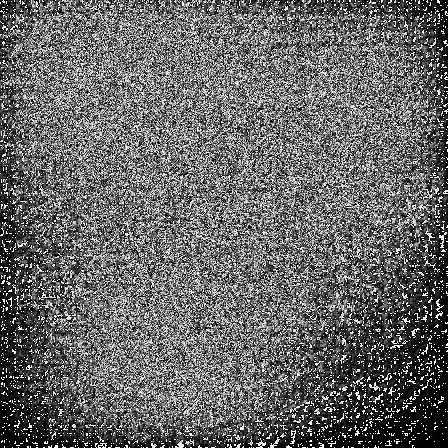

In [645]:
Image.fromarray(deconv_map_index[qid].astype(np.uint8), mode='L')

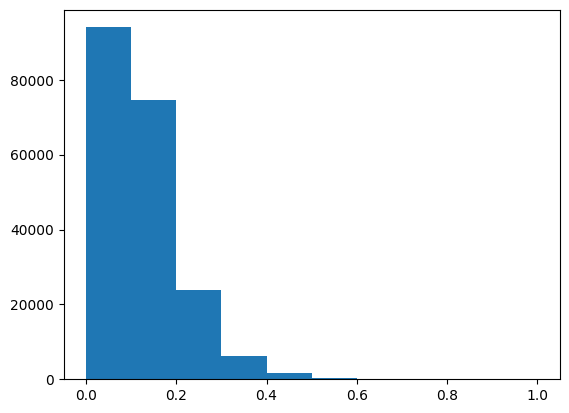

In [425]:
data = deconv_map_index[2023431]
data = (data-data.min())/(data.max()-data.min()+1e-6)
counts, bins = np.histogram(data)
plt.hist(bins[:-1], bins, weights=counts)
plt.show()

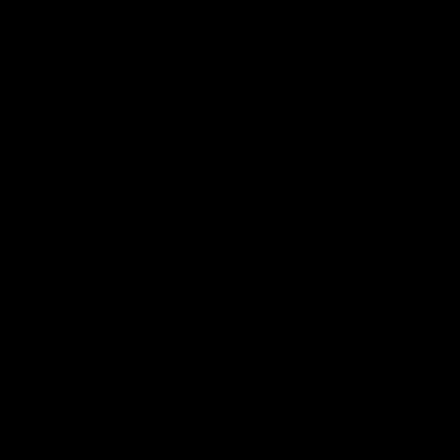

In [619]:
mask = deconv_map_index[1679522]
Image.fromarray(mask.astype(np.uint8))

In [384]:
compare_maps(list(deconv_map_index.keys())[0]//10, kazemi=False, hiecoatt=False, sans2=False)

Question ID: 202343


KeyError: 202343

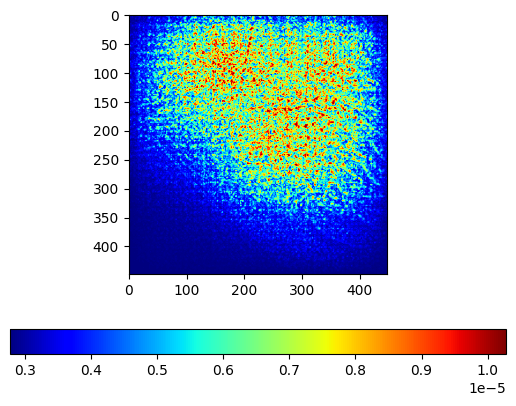

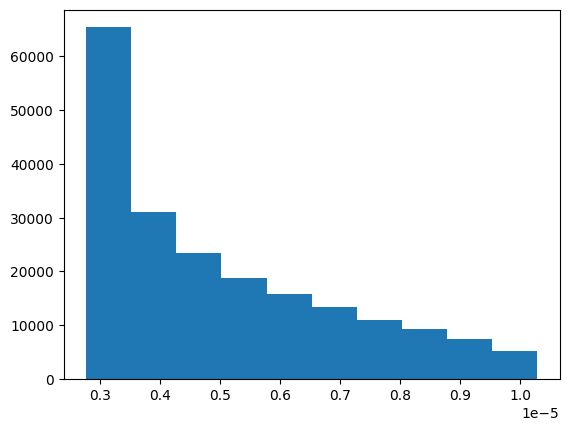

In [744]:
RR, CC = 7, 0
# print(deconv_maps[RR][CC])

ans = deconv_maps

import pylab as plt
# Z=np.linalg.norm(ans[RR][CC]['attr_heatmap'], axis=2)
Z=np.max(np.abs(ans[RR][CC]['attr_heatmap']), axis=2)
Z = (Z - Z.min())
Z = Z / (Z.max() + 1e-6)
Z -= Z.mean()
Z = Z / (Z.std() + 1e-6)
Z = 1 / (1 + np.exp(-Z))
Z = Z / Z.sum()

im = plt.imshow(Z, cmap='jet')
plt.colorbar(im, orientation='horizontal')
plt.show()

# print(ans[RR][CC])
data = Z
counts, bins = np.histogram(data)
plt.hist(bins[:-1], bins, weights=counts)
plt.show()
# display(Image.fromarray(Z))

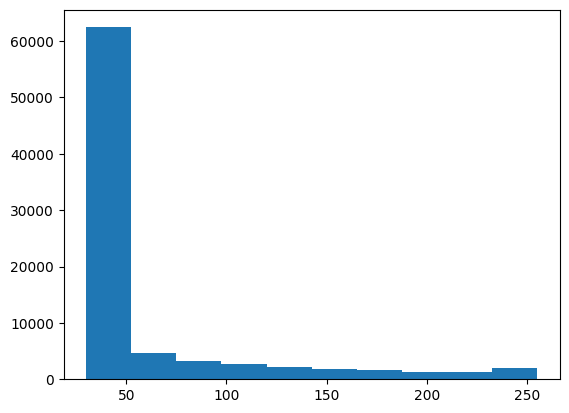

In [196]:
data = np.asarray(Image.open(get_human_map(	812512)))
# data = (data-data.mean())/(data.std()+1e-6)+255/2
counts, bins = np.histogram(data)
plt.hist(bins[:-1], bins, weights=counts)
plt.show()

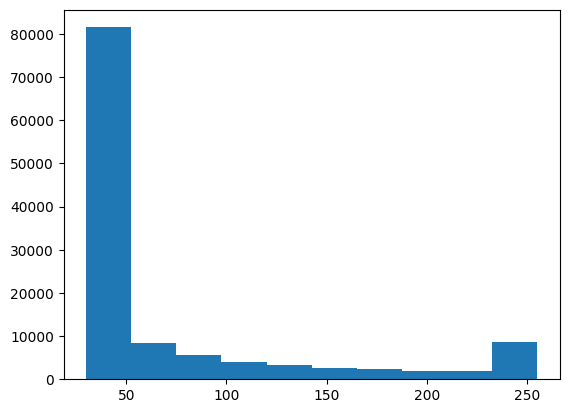

In [681]:
data = np.asarray(Image.open(get_human_map(2023430)))
# data = (data-data.mean())/(data.std()+1e-6)+255/2
counts, bins = np.histogram(data)
plt.hist(bins[:-1], bins, weights=counts)
plt.show()

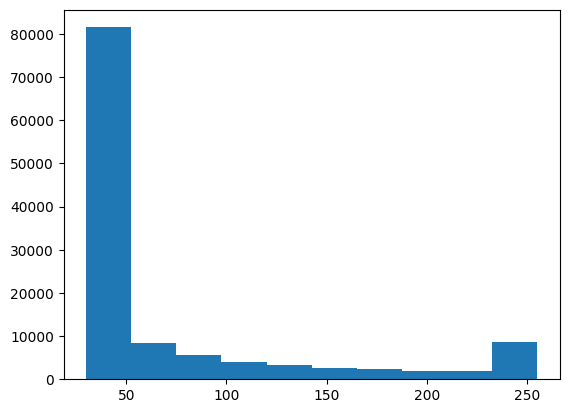

In [404]:
data = np.asarray(Image.open(get_human_map(2023430)))
# data = (data-data.mean())/(data.std()+1e-6)+255/2
counts, bins = np.histogram(data)
plt.hist(bins[:-1], bins, weights=counts)
plt.show()

In [414]:
human_map_av = [np.asarray(Image.open(get_human_map(i))).flatten() for i in human_map_qids]


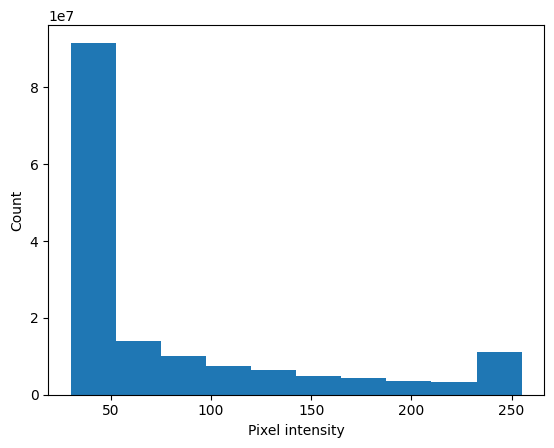

In [421]:
def plot_distribution(data):
    # data = (data-data.mean())/(data.std()+1e-6)+255/2
    counts, bins = np.histogram(data)
    plt.hist(bins[:-1], bins, weights=counts)
    plt.xlabel('Pixel intensity')
    plt.ylabel('Count')
    plt.show()
plot_distribution(np.concatenate(human_map_av, axis=0))

In [ ]:

plot_distribution(av_saliency)

In [420]:
len(data[data > int(255/10*9)])/len(data)

0.07275391817844759

Question ID: 2023430
Question: Is this mobile ready for use?
Answer: no
Human attention:


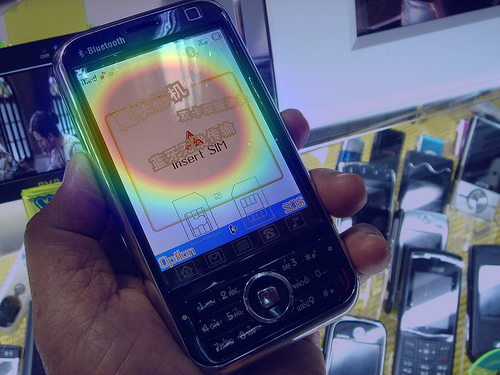

In [265]:
compare_maps(2023430, hiecoatt=False, sans2=False)

Now we compare 